# 0. Environment

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# 1. Getting the FSD Dataset


In [ ]:
import requests
import os
from concurrent.futures import ThreadPoolExecutor

def download_file(url, dest_folder):
  """
  Downloads a file from a given URL and saves it to a destination folder.

  Args:
  - url (str): The URL of the file to download.
  - dest_folder (str): The destination folder where the file should be saved.
  """
  if not os.path.exists(dest_folder):
    os.makedirs(dest_folder)

  response = requests.get(url, stream=True)
  filename = os.path.join(dest_folder, url.split('/')[-1])

  with open(filename, 'wb') as file:
    for chunk in response.iter_content(chunk_size=8192):
      file.write(chunk)

  return filename  # return the saved file path

def download_files_in_parallel(url_list, dest_folder):
  """
  Downloads files from a list of URLs in parallel and saves them to a destination folder.

  Args:
  - url_list (list): List of URLs to download.
  - dest_folder (str): The destination folder where files should be saved.

  Returns:
  - list: List of saved file paths.
  """
  with ThreadPoolExecutor() as executor:
    return list(executor.map(download_file, url_list, [dest_folder] * len(url_list)))

download_eval = True
download_dev = True

urls = []
if download_eval:
  urls.append('https://zenodo.org/record/4060432/files/FSD50K.eval_audio.z01')
  urls.append('https://zenodo.org/record/4060432/files/FSD50K.eval_audio.zip')

if download_dev:
  urls.append('https://zenodo.org/record/4060432/files/FSD50K.dev_audio.z01')
  urls.append('https://zenodo.org/record/4060432/files/FSD50K.dev_audio.z02')
  urls.append('https://zenodo.org/record/4060432/files/FSD50K.dev_audio.z03')
  urls.append('https://zenodo.org/record/4060432/files/FSD50K.dev_audio.z04')
  urls.append('https://zenodo.org/record/4060432/files/FSD50K.dev_audio.z05')
  urls.append('https://zenodo.org/record/4060432/files/FSD50K.dev_audio.zip')

downloaded_files = download_files_in_parallel(urls, "/content/")
print(downloaded_files)


['/content/FSD50K.eval_audio.z01', '/content/FSD50K.eval_audio.zip', '/content/FSD50K.dev_audio.z01', '/content/FSD50K.dev_audio.z02', '/content/FSD50K.dev_audio.z03', '/content/FSD50K.dev_audio.z04', '/content/FSD50K.dev_audio.z05', '/content/FSD50K.dev_audio.zip']


In [ ]:
# decompress the eval set:
!zip -s 0 /content/FSD50K.eval_audio.zip --out unsplit.zip
!unzip unsplit.zip

Streaming output truncated to the last 5000 lines.
  inflating: FSD50K.eval_audio/109820.wav  
  inflating: FSD50K.eval_audio/323793.wav  
  inflating: FSD50K.eval_audio/18366.wav  
  inflating: FSD50K.eval_audio/365102.wav  
  inflating: FSD50K.eval_audio/64620.wav  
  inflating: FSD50K.eval_audio/172858.wav  
  inflating: FSD50K.eval_audio/250098.wav  
  inflating: FSD50K.eval_audio/171973.wav  
  inflating: FSD50K.eval_audio/402569.wav  
  inflating: FSD50K.eval_audio/189620.wav  
  inflating: FSD50K.eval_audio/137894.wav  
  inflating: FSD50K.eval_audio/390340.wav  
  inflating: FSD50K.eval_audio/405267.wav  
  inflating: FSD50K.eval_audio/135848.wav  
  inflating: FSD50K.eval_audio/369598.wav  
  inflating: FSD50K.eval_audio/110584.wav  
  inflating: FSD50K.eval_audio/97756.wav  
  inflating: FSD50K.eval_audio/236294.wav  
  inflating: FSD50K.eval_audio/369265.wav  
  inflating: FSD50K.eval_audio/93790.wav  
  inflating: FSD50K.eval_audio/344679.wav  
  inflating: FSD50K.eval_audi

In [ ]:
# decompress dev audio
!zip -s 0 /content/FSD50K.dev_audio.zip --out unsplit.zip
!unzip unsplit.zip

Streaming output truncated to the last 5000 lines.
  inflating: FSD50K.dev_audio/256339.wav  
  inflating: FSD50K.dev_audio/182395.wav  
  inflating: FSD50K.dev_audio/138791.wav  
  inflating: FSD50K.dev_audio/373663.wav  
  inflating: FSD50K.dev_audio/273192.wav  
  inflating: FSD50K.dev_audio/100332.wav  
  inflating: FSD50K.dev_audio/68954.wav  
  inflating: FSD50K.dev_audio/140891.wav  
  inflating: FSD50K.dev_audio/337503.wav  
  inflating: FSD50K.dev_audio/126304.wav  
  inflating: FSD50K.dev_audio/75270.wav  
  inflating: FSD50K.dev_audio/96626.wav  
  inflating: FSD50K.dev_audio/79748.wav  
  inflating: FSD50K.dev_audio/247730.wav  
  inflating: FSD50K.dev_audio/27657.wav  
  inflating: FSD50K.dev_audio/255252.wav  
  inflating: FSD50K.dev_audio/82678.wav  
  inflating: FSD50K.dev_audio/329894.wav  
  inflating: FSD50K.dev_audio/77543.wav  
  inflating: FSD50K.dev_audio/375042.wav  
  inflating: FSD50K.dev_audio/381503.wav  
  inflating: FSD50K.dev_audio/373669.wav  
  inflatin

# 2. Load SegSep and dependencies



In [ ]:
!pip install torchaudio
!pip install torchinfo
!pip install essentia

!pip install git+https://github.com/BenjaminOlsen/SegSep.git
!pip install git+https://github.com/huggingface/transformers.git
#!pip install git+https://github.com/facebookresearch/segment-anything.git
!pip install git+https://github.com/BenjaminOlsen/segment-anything.git

!pip install mir_eval # todo! switch to museval

!pip install gdown

!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

In [ ]:
import pytz
import torch
import random
import segsep
import torchaudio
import importlib
import numpy as np
import segment_anything
import essentia.standard as es
import matplotlib.pyplot as plt

from statistics import mean

from torchinfo import summary
from datetime import datetime

from segsep.utils import print_tensor_stats, calculate_energy, spectral_centroid_waveform, should_skip_chunk
from segsep.datasets import AudioPairDataset, generate_audio_metadata
from segsep.loss_acc import LOGL2loss_freq, si_snr, L2loss_freq, L1loss_freq, LOGL1loss_freq
from segsep.train_validate import train, validate
from segsep.sam_sep import SamWrapper
from segsep.train_sam_image_encoder import run_train_validate


from segment_anything import sam_model_registry, SamPredictor

from mir_eval.separation import bss_eval_sources #todo: switch to museval

In [ ]:
#############################################
###### JUST TO RELOAD segment-anything ######
#############################################

import importlib

!pip uninstall -y segment_anything
!pip install git+https://github.com/BenjaminOlsen/segment-anything.git
importlib.reload(segment_anything)
from segment_anything import sam_model_registry, SamPredictor


In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

cuda


In [ ]:
!cp /content/drive/MyDrive/dev_audio_metadata.json .
!cp /content/drive/MyDrive/eval_audio_metadata.json .

In [ ]:
!gdown 1--x0zlhVU-XgKK2wgIia9pBHaBUQnk5C # dev_audio_metadata.json
!gdown 11erbFCd-tlN4jRSdWjCynQ-1zfblU9y2 # eval_audio_metadata.json

Downloading...
From: https://drive.google.com/uc?id=1--x0zlhVU-XgKK2wgIia9pBHaBUQnk5C
To: /content/dev_audio_metadata.json
100% 24.2M/24.2M [00:00<00:00, 146MB/s] 
Downloading...
From: https://drive.google.com/uc?id=11erbFCd-tlN4jRSdWjCynQ-1zfblU9y2
To: /content/eval_audio_metadata.json
100% 6.01M/6.01M [00:00<00:00, 61.9MB/s]


For the STFT to result in a tensor of precisely spec_dim shape, with `spec_dim[0]` time frames and `spec_dim[1]` frequency bins then the following must be true:

With `center=True` for the stft, each of the input audio is padded such that the kth frame is centered at index `k*hop_len` samples. Therefore, to have precisely `spec_len[0]` frames, the last sample should have index value `(spec_len[0]-1)`, so the audio length input to the STFT must be equal to `(spec_len[0]-1)*hop_len`.

(Conversely, the time bin of the corresponding

This input to the STFT is the *output* of the downsampler, so if we have a downsampling ratio of `ρ`, and an input audio sample count of `chunk_size`, then the number of samples in the downsampled audio is `chunk_size / ρ`, which must be equal to `(spec_len[0]-1)*hop_len`

For real valued signals, the FFT is symetrical, and returns only the values for `ω` in `[0, 1, ... n_fft//2 + 1]` Therefore `n_fft = 2 * (spec_dim[1] - 1)`

---

In a blind, zero-shot setting SAM doesn't seem to generalize very well to audio. It seems to attempt to group obvious visual features together, but stumbles on the general spectral mixing that sound exhibits. This is, perhaps, the main difficulty of applying semantic segmentation models to sound: in those datasets, there is typically one class outcome per pixel of the output segmentation map. Indeed, there are probabilities* generated for each output class, which are then thresholded in order to producce the final map, but the cost is calculated (SAUCE - DOUBLE CHECK THIS) using cross-entropy loss

# Load SamWrapper Model

In [ ]:
model = SamWrapper(spec_dim=(256,256),
                   sample_rate=44100,
                   resample_rate=22050,
                   saved_model_state_dict=None).to(device)

SamWrapper model n_fft: 510, win len: 510, hop len: 63, sample/resample: 2.0 -> input_chunk_size 32130.0


In [ ]:
summary(model=model,
        input_size=(3, model.input_chunk_size),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                                                Input Shape          Output Shape         Param #              Trainable
SamWrapper2 (SamWrapper2)                                              [3, 521730]          [3, 521730]          --                   True
├─Resample (downsampler)                                               [3, 521730]          [3, 260865]          --                   --
├─Sam (sam_model)                                                      --                   --                   --                   True
│    └─ImageEncoderViT (image_encoder)                                 [1, 3, 1024, 1024]   [1, 256, 64, 64]     5,242,880            True
│    │    └─PatchEmbed (patch_embed)                                   [1, 3, 1024, 1024]   [1, 64, 64, 1280]    984,320              True
│    │    └─ModuleList (blocks)                                        --                   --                   629,880,320          True
│    │    └─Sequential (

In [ ]:
import os
def walk_through_dir(dir_path):
  """
  Walks through dir_path returning its contents.
  Args:
    dir_path (str or pathlib.Path): target directory

  Returns:
    A print out of:
      number of subdiretories in dir_path
      number of images (files) in each subdirectory
      name of each subdirectory
  """
  for dirpath, dirnames, filenames in os.walk(dir_path):
    print(f"There are {len(dirnames)} directories and {len(filenames)} files in '{dirpath}'.")

In [ ]:
fsd_eval_location = '/content/FSD50K.eval_audio'
eval_metadata_json = '/content/eval_audio_metadata.json'
fsd_dev_location = '/content/FSD50K.dev_audio'
dev_metadata_json = '/content/dev_audio_metadata.json'

walk_through_dir(fsd_dev_location)
walk_through_dir(fsd_eval_location)


In [ ]:
generate_audio_metadata(fsd_dev_location, 'dev_metadata_json_test.json', verbose=False)

In [ ]:
test_dataset = AudioPairDataset(audio_dir=fsd_eval_location,
                           json_path=eval_metadata_json,
                           centroid_diff_hz=4000.0,
                           min_duration_s = model.input_chunk_size/model.resample_rate,
                           dummy_mode=False)

found 913 files of length 23.66122448979592s or longer


# TESTING new version of SamWrapper


In [ ]:
import cv2
import torch
import torchaudio
import torch.nn.functional as F
import torchaudio.transforms as T
from transformers import SamModel, SamConfig
from segment_anything import sam_model_registry

# --------------------------------------------------------------------------------------------------
def tensor_to_uint8(tensor, min_val=0, max_val=255):
  """Normalize tensor to [min_val, max_val] range and convert to uint8."""
  # Linearly scale tensor values
  tensor = (tensor - tensor.min()) / (tensor.max() - tensor.min())
  tensor = tensor * (max_val - min_val) + min_val
  return tensor.byte()  # Convert to uint8 type

# --------------------------------------------------------------------------------------------------
class SamWrapper2(torch.nn.Module):
  def __init__(self,
               spec_dim=(1024, 1024),
               sample_rate=44100,
               resample_rate=22050):
    super().__init__()

    self.spec_dim = spec_dim
    self.n_fft = 2*(self.spec_dim[1]-1)
    self.win_length = self.n_fft
    self.hop_length = self.n_fft//8
    self.sample_rate = sample_rate
    self.resample_rate = resample_rate
    self.downsampler = T.Resample(orig_freq=self.sample_rate, new_freq=self.resample_rate)
    self.upsampler = T.Resample(orig_freq=self.resample_rate, new_freq=self.sample_rate)
    self.input_chunk_size = (self.sample_rate / self.resample_rate) * (self.spec_dim[0]-1) * self.hop_length

    if not self.input_chunk_size.is_integer():
      print(f"WARNING, noninteger input chunk size, choose your sample rate, resample rate to divide cleanly!")
    print(f"SamWrapper model n_fft: {self.n_fft}, win len: {self.win_length}, hop len: {self.hop_length}, sample/resample: {self.sample_rate / self.resample_rate} -> input_chunk_size {self.input_chunk_size}")

    self.input_chunk_size = int(self.input_chunk_size)

    # use facebook research repo directly

    sam_checkpoint = "sam_vit_h_4b8939.pth"
    model_type = "vit_h"
    self.sam_model = sam_model_registry[model_type](checkpoint=sam_checkpoint)
    self.predictor = SamPredictor(self.sam_model)

  # ---------------------------------------------------------------
  def encoder(self, x): # returns magnitude spectrum, phase spectrum
    x = self.downsampler(x)
    sample_cnt = x.shape[-1]
    ideal_hop_length = sample_cnt / (self.spec_dim[0] - 1)

    if not ideal_hop_length.is_integer():
      print(f"WARNING, choose audio chunk size to be integer multiple of hop_length {self.hop_length}! != {ideal_hop_length}")

    X = torch.stft( input=x,
                    n_fft=self.n_fft,
                    win_length=self.win_length,
                    window=torch.hann_window(self.win_length).to(x.device),
                    center=True,
                    hop_length=self.hop_length,
                    onesided=True,
                    return_complex=True)

    return X

  # ---------------------------------------------------------------
  def decoder(self, X): #takes complex spectrum, returns audio
    x = torch.istft( input=X,
                    n_fft=self.n_fft,
                    win_length=self.win_length,
                    window=torch.hann_window(self.win_length).to(X.device),
                    center=True,
                    hop_length=self.hop_length,
                    onesided=True,
                    return_complex=False)
    x = self.upsampler(x)
    return x

  # ---------------------------------------------------------------
  # returns predicted vocals:
  def forward(self,
              audio_in,
              input_points=None,
              point_labels=None,
              input_boxes=None,
              upscale_mask=False,
              debug=False):
    # normalize the audio
    mean = torch.mean(audio_in)
    std = torch.std(audio_in)
    audio_in = (audio_in - mean) / (std + 1e-8)

    if torch.isnan(audio_in).any():
      print("forward(): input audio contains nan after normalization!!!")

    # get the magnitude and phase spectra from the encoder (STFT)
    X = self.encoder(audio_in)
    input_spec_shape = X.shape

    mix_spec_in = torch.abs(X)
    phase_in = torch.angle(X)

    if debug:
      print(f"forward(): mix_spec {mix_spec_in.shape}, phase_in {phase_in.shape}")
    # make sure the tensors are in the correct shape for the backbone : 1024,1024
    if(mix_spec_in.shape[1] != 1024 or mix_spec_in.shape[2] != 1024):
      if debug:
        print(f"forward(): interpolating input mix spec from {mix_spec_in.shape} to (3,1024,1024)")
      mix_spec_in_transformed = torch.nn.functional.interpolate(mix_spec_in.unsqueeze(0), size=(1024,1024), mode='bilinear').squeeze(0)
    else:
      if debug:
        print(f"forward(): input mix spec from {mix_spec_in.shape} already correct shape for model")
      mix_spec_in_transformed = mix_spec_in

    # convert the spectrogram into a uint8 image
    spec_img = tensor_to_uint8(mix_spec_in_transformed)

    if debug:
      print(f"forward(): mix_spec_in.shape: {mix_spec_in.shape}; mix_spec_in_transformed.shape: {mix_spec_in_transformed.shape}; spec_img.shape {spec_img.shape}")

    # calculates the image embeddings:
    self.predictor.set_image(spec_img)

    # runs the image imbeddings through the mask decoder and returns the masks
    masks, iou_scores, low_res_logits = self.predictor.predict_torch(
                                              point_coords=input_points,
                                              point_labels=point_labels,
                                              multimask_output=True,
                                              return_logits=False
                                              )

    #print(f"sam_model iou_scores: {outputs.iou_scores.shape}; {outputs.iou_scores}")
    #img_embeddings = self.sam_model.vision_encoder(mix_spec_in.unsqueeze(0))
    #print(f"img_embeddings.last_hidden_state.shap: {img_embeddings.last_hidden_state.shape}")
    #mask = self.sam_model.mask_decoder(img_embeddings.last_hidden_state)
    #print(f"mask decoder output: {mask}")

    pred_masks = low_res_logits.squeeze()

    if debug:
      print(f"forward(): sam_model outputs masks shape: {masks.shape}; pred_masks.shape: {pred_masks.shape}")


    if mix_spec_in.shape != pred_masks.shape:
      if debug:
        print(f"mix spec in shape: {mix_spec_in.shape} != pred_masks.shape: {pred_masks.shape}")
      if upscale_mask: # upscale the predicted mask to the size of the input spectrum

        upscale_size = (mix_spec_in.shape[1], mix_spec_in.shape[2])
        if debug:
            print(f"forward(): upscaling predicted mask from {pred_masks.shape} to {upscale_size}")

        pred_masks = torch.nn.functional.interpolate(pred_masks.unsqueeze(0), size=upscale_size, mode='bilinear').squeeze(0)

        # filter the predicted mask with the original mix spectrum magnitude
        if debug:
          print(f"forward(): multiplying pred mask {pred_masks.shape} and mix spec {mix_spec_in.shape}")
        pred_mag = torch.mul(pred_masks, mix_spec_in)


      else : # downscale the input spectrum to predicted magnitude spectrum's size
        kernel_size = (2,2) # ...first do a average pooling
        mix_spec_avg_pool = torch.nn.functional.avg_pool2d(mix_spec_in, kernel_size)
        downscale_size = (pred_masks.shape[1], pred_masks.shape[2])

        downscaled_mix_spec = torch.nn.functional.interpolate(mix_spec_in.unsqueeze(0), size=downscale_size, mode='bilinear').squeeze(0)

        if debug:
          print(f"forward(): downscaling mix spec from {mix_spec_in.shape} -> avg pool {mix_spec_avg_pool.shape} -> interpolate {downscaled_mix_spec.shape}")

        pred_mag = torch.mul(pred_masks, downscaled_mix_spec)
    else:

      pred_mag = torch.mul(pred_masks, mix_spec_in)

    # resynthesize the estimated source audio
    if pred_mag.squeeze().shape != input_spec_shape:
      if debug:
        print(f"forward(): resizing predicted mag spec from {pred_mag.shape} to {input_spec_shape}")
      pred_mag = torch.nn.functional.interpolate(pred_mag.unsqueeze(0), size=(input_spec_shape[1], input_spec_shape[2]), mode='bilinear').squeeze(0)

    pred = (pred_mag * torch.cos(phase_in)) + (1.0j * pred_mag * torch.sin(phase_in))

    if debug:
      print(f"forward(): predicted spectrum shape: {pred.shape}")
    pred_audio = self.decoder(pred.squeeze())
    return pred_audio, mix_spec_in, phase_in, pred_mag, pred_masks.squeeze(), iou_scores.squeeze()


In [ ]:
# reload model
model = SamWrapper2(spec_dim=(1024,1024),
                   sample_rate=44100,
                   resample_rate=22050).to(device)

SamWrapper model n_fft: 2046, win len: 2046, hop len: 255, sample/resample: 2.0 -> input_chunk_size 521730.0


In [ ]:
x = torch.rand(3, model.input_chunk_size)
pred_audio, mix_spec_in, phase_in, pred_mag, pred_masks, iou_scores = model(x.to(device),
                                                                            upscale_mask=True,
                                                                            debug=True)

forward(): mix_spec torch.Size([3, 1024, 1024]), phase_in torch.Size([3, 1024, 1024])
forward(): input mix spec from torch.Size([3, 1024, 1024]) already correct shape for model
forward(): mix_spec_in.shape: torch.Size([3, 1024, 1024]); mix_spec_in_transformed.shape: torch.Size([3, 1024, 1024]); spec_img.shape torch.Size([3, 1024, 1024])
forward(): sam_model outputs masks shape: torch.Size([1, 3, 3, 1024]); pred_masks.shape: torch.Size([3, 256, 256])
mix spec in shape: torch.Size([3, 1024, 1024]) != pred_masks.shape: torch.Size([3, 256, 256])
forward(): upscaling predicted mask from torch.Size([3, 256, 256]) to (1024, 1024)
forward(): multiplying pred mask torch.Size([3, 1024, 1024]) and mix spec torch.Size([3, 1024, 1024])
forward(): predicted spectrum shape: torch.Size([3, 1024, 1024])


# Run Zero Shot Prediction

In [ ]:
# run prediction
rand_idx = random.randint(0, len(test_dataset)-1)

mix, longer_audio, padded_audio, info_long, info_short, pad_offset = test_dataset.get_info(rand_idx)
print(f'choosing idx {rand_idx}; long: {info_long["filename"]}, short: {info_short["filename"]}')

sr_l = info_long["sample_rate"]
sr_s = info_short["sample_rate"]
if (sr_l != sr_s):
  print(f"watch out, sample rate difference between audios: {sr_l} vs. {sr_s}")

# sample rate
sr=sr_l

print(f"mix len: {mix.shape}, longer: {longer_audio.shape}, shorter: {padded_audio.shape}, long info: {info_long}, short info: {info_short}, offset: {pad_offset}")

with torch.inference_mode():
  # trim input audio to ideal chunk size
  start_idx = 0
  while start_idx < mix.shape[1] - model.input_chunk_size:

    mix_chunk = mix[:, start_idx:start_idx+model.input_chunk_size]
    longer_audio_chunk = longer_audio[:,  start_idx:start_idx+model.input_chunk_size]

    #just for info about how much trimming is going on
    trim_size_l = longer_audio.shape[1] - model.input_chunk_size
    print(f"trimming {trim_size_l} samples = {trim_size_l/sr:.4f}s: ({longer_audio.shape[1]/sr:.4f}s -> {longer_audio_chunk.shape[1]/sr:.4f}s) from  audio to fit into model chunk")

    padded_audio_chunk = padded_audio[:, start_idx:start_idx+model.input_chunk_size]
    print(f"trimming {padded_audio.shape[1] - model.input_chunk_size} samples from padded audio to fit into model chunk")

    if should_skip_chunk(padded_audio_chunk):
      print(f"no energy in shorter audio chunk idx {start_idx}->{start_idx+model.input_chunk_size}")
      start_idx += model.input_chunk_size
    else:
      print(f"plenty of energy in shorter audio chunk idx {start_idx}->{start_idx+model.input_chunk_size}")
      break

  # if, finally, there is still nothing in the padded audio chunk, there's a problem
  if should_skip_chunk(padded_audio_chunk):
    print(f"NO audio energy in shorter audio! check yourself")

  # get the spectra for the different chunks
  spec_mix = torch.abs(model.encoder(mix_chunk.to(device)))
  spec_long = torch.abs(model.encoder(longer_audio_chunk.to(device)))
  spec_short = torch.abs(model.encoder(padded_audio_chunk.to(device)))

  ### TODO
  ### FIX THIS CENTROID CACA!!!!!!
  #####

  """
  # get the spectral centroid of the audio chunks
  long_chunk_info = spectral_centroid_waveform(longer_audio_chunk, sample_rate=sr, n_fft=model.n_fft, hop_length=model.hop_length)
  short_chunk_info = spectral_centroid_waveform(padded_audio_chunk, sample_rate=sr, n_fft=model.n_fft, hop_length=model.hop_length)
  print(f"long chunk info: {long_chunk_info}")
  print(f"short chunk info: {short_chunk_info}")



  # choose x, y to be point inside shorter audio chunk
  time_spectroid_idx = short_chunk_info["time_centroid_s"] * sr / model.hop_length
  # frequency = i * (sample_rate / n_fft)
  freq_spectroid_idx = short_chunk_info["spectral_centroid_hz"] * model.n_fft / sr

  print(f"time spec idx: {time_spectroid_idx}, freq spec idx: {freq_spectroid_idx}")

  input_point = torch.tensor((time_spectroid_idx, freq_spectroid_idx)).unsqueeze(0).unsqueeze(0).unsqueeze(0)
  """

  # add a channel to the audio to fit with the SAM input tensor dimensions
  mix_3ch = torch.cat([mix_chunk, mix_chunk, 1-mix_chunk], dim=0)

  #####
  # just take the maximum values of the shorter audio's spectrum and use that as input points:
  prompt_point_cnt = 4
  # do a cheap trick to not have the points clump together in the spectrogram
  stride = 80
  k = stride * prompt_point_cnt

  # flatten mag spectrum
  short_spec_flat = spec_short.reshape(-1)
  # pick max values
  max_values, max_indices = torch.topk(short_spec_flat, k)
  # convert to 2d indices
  print(f"max indices shape: {max_indices.shape} spec short shape: {spec_short.shape}; short_spec_flat.shape : {short_spec_flat.shape}")
  max_freq_indices, max_time_indices = np.unravel_index(max_indices.cpu().numpy(), spec_short.squeeze().shape)
  points = list(zip(max_time_indices,max_freq_indices))
  points = points[::stride]
  input_points = torch.tensor(points) # has shape `nb_points_per_image`, `2`
  point_labels = torch.ones(input_points.shape[0]) # all ones -> all foreground points

  # add  `batch_size`, `point_batch_size`:
  input_points = input_points.unsqueeze(0)
  point_labels = point_labels.unsqueeze(0) #.unsqueeze(0)

  print(f"input_points.shape: {input_points.shape}; point labels shape: {point_labels.shape}")
  pred_audio, mix_spec_in, phase_in, pred_mag, pred_mask, iou_scores = model(mix_3ch.to(device),
                                                                             input_points=input_points.to(device),
                                                                             point_labels=point_labels.to(device),
                                                                             upscale_mask=True,
                                                                             debug=True
                                                                             )


  pred_spec = torch.abs(model.encoder(pred_audio))
  print(f"iou scores: {iou_scores}")
  print_tensor_stats(mix_3ch, "mix 3 channel")
  print_tensor_stats(pred_mask, "predicted mask")
  print_tensor_stats(pred_audio, "predicted audio")
  print(f"info short: {info_short}")
  print(f"info long: {info_long}")




choosing idx 2149; long: /content/FSD50K.eval_audio/78202.wav, short: /content/FSD50K.eval_audio/383494.wav
mix len: torch.Size([1, 808195]), longer: torch.Size([1, 808195]), shorter: torch.Size([1, 808195]), long info: {'sample_rate': 44100, 'filename': '/content/FSD50K.eval_audio/78202.wav', 'spectral_centroid': 6788.903008792749, 'sample_cnt': 808195}, short info: {'sample_rate': 44100, 'filename': '/content/FSD50K.eval_audio/383494.wav', 'spectral_centroid': 1618.2205867993357, 'sample_cnt': 44330}, offset: 379841
trimming 286465 samples = 6.4958s: (18.3264s -> 11.8306s) from  audio to fit into model chunk
trimming 286465 samples from padded audio to fit into model chunk
plenty of energy in shorter audio chunk idx 0->521730
max indices shape: torch.Size([320]) spec short shape: torch.Size([1, 1024, 1024]); short_spec_flat.shape : torch.Size([1048576])
input_points.shape: torch.Size([1, 4, 2]); point labels shape: torch.Size([1, 4])
forward(): mix_spec torch.Size([3, 1024, 1024]), p

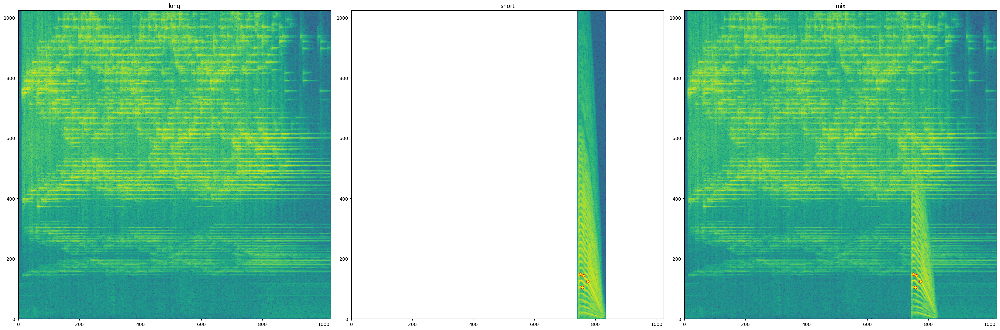

In [ ]:
 # plot input audio:
fig, axs = plt.subplots(1, 3, figsize=(30,10))

axs[0].pcolormesh(10*torch.log10(spec_long.squeeze()).detach().cpu())
axs[0].set_title('long')

axs[1].pcolormesh(10*torch.log10(spec_short.squeeze()).detach().cpu())
axs[1].set_title('short')
dr = model.sample_rate / model.resample_rate #downsample ratio

axs[1].plot

axs[2].pcolormesh(10*torch.log10(spec_mix.squeeze()).detach().cpu())
axs[2].set_title('mix')

#pad_offset is expressed from the original audio before downsampling!
input_points = input_points.squeeze()
for t_idx, f_idx in input_points:
  #t_idx = (info_short["time_centroid_s"]*sr + pad_offset)/(model.hop_length*dr)
  #f_idx = info_short["spectral_centroid_hz"] * model.n_fft / sr
  #print(f" centroid: {info_short['time_centroid_s']:.3f}s, pad offset: {pad_offset} samples= {pad_offset/sr:.4f}s / {model.hop_length} hop len = {pad_offset/model.hop_length:.2f} hop idx -> t idx: {t_idx:.2f}. f_idx: {f_idx:.2f}")
  axs[1].plot(t_idx, f_idx, marker="o", markersize=6, markeredgecolor="red", markerfacecolor="yellow")
  axs[2].plot(t_idx, f_idx, marker="o", markersize=6, markeredgecolor="red", markerfacecolor="yellow")

plt.tight_layout()
plt.show()

In [ ]:
print_tensor_stats(spec_long, "spec long")
print_tensor_stats(spec_short, "spec short")
print_tensor_stats(spec_mix, "spec mix")

spec long            - torch.float32   - shape: torch.Size([1, 1024, 1024])   (magnitude) max: 179.4029, min   0.0000, mean   1.1050, std:   3.4633
spec short           - torch.float32   - shape: torch.Size([1, 1024, 1024])   (magnitude) max:   0.5183, min   0.0000, mean   0.0010, std:   0.0094
spec mix             - torch.float32   - shape: torch.Size([1, 1024, 1024])   (magnitude) max: 179.4029, min   0.0000, mean   1.1051, std:   3.4633


In [ ]:
spec_long_uint8 = tensor_to_uint8(spec_long)

In [ ]:
def print_tensor_stats(t, title=None):
  tensor_type = t.dtype
  shape = t.shape
  t = torch.abs(t)
  max = torch.max(t)
  min = torch.min(t)
  mean = torch.mean(t.float())
  std = torch.std(t.float())
  print(f"{title:20} - {str(tensor_type):15} - shape: {str(shape):29} (magnitude) max: {max:8.4f}, min {min:8.4f}, mean {mean:8.4f}, std: {std:8.4f}")

In [ ]:
print_tensor_stats(spec_long_uint8, "spec long _uint8")

spec long _uint8     - torch.uint8     - shape: torch.Size([1, 1024, 1024])   (magnitude) max: 255.0000, min   0.0000, mean   1.9404, std:   5.8675


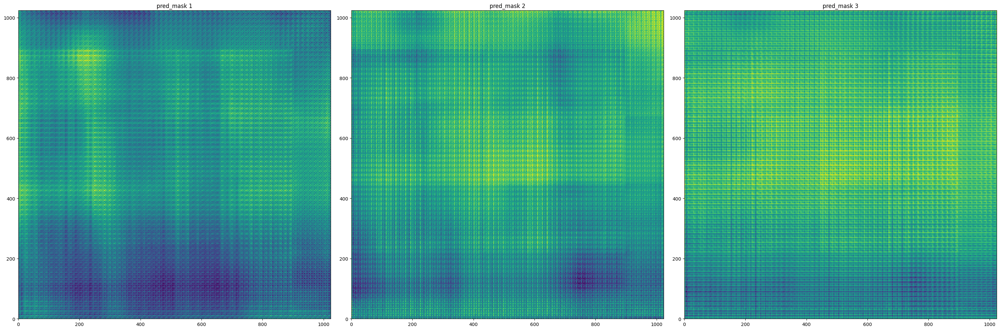

In [ ]:
# plot predicted masks:

fig, axs = plt.subplots(1,3, figsize=(30,10))
axs[0].pcolormesh(pred_mask[0].squeeze().detach().cpu())
axs[0].set_title('pred_mask 1')
axs[1].pcolormesh(pred_mask[1].squeeze().detach().cpu())
axs[1].set_title('pred_mask 2')
axs[2].pcolormesh(pred_mask[2].squeeze().detach().cpu())
axs[2].set_title('pred_mask 3')
plt.tight_layout()
plt.show()

orig shape: torch.Size([3, 1024, 1024]); pooled1 shape: torch.Size([3, 256, 256]); pooled2 shape: torch.Size([3, 64, 64])


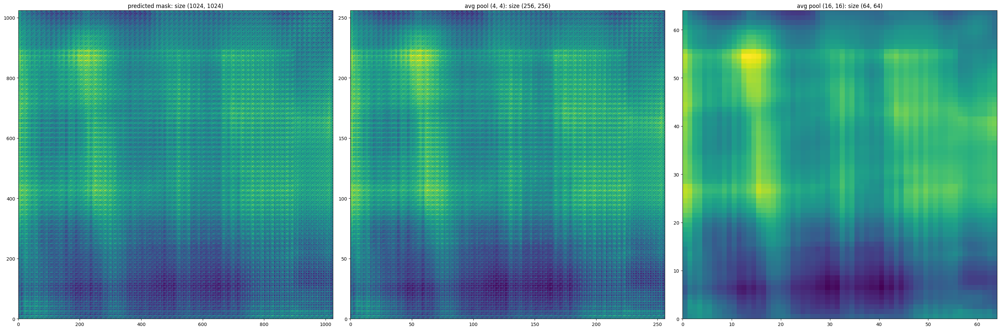

In [ ]:
# Average pool away the weird pattern!!
kernel_size1 = (4,4)
kernel_size2 = (16,16)
pooled1 = torch.nn.functional.avg_pool2d(pred_mask, kernel_size1)
pooled2 = torch.nn.functional.avg_pool2d(pred_mask, kernel_size2)
print(f"orig shape: {pred_mask.shape}; pooled1 shape: {pooled1.shape}; pooled2 shape: {pooled2.shape}")
fig, axs = plt.subplots(1,3, figsize=(30,10))
axs[0].pcolormesh(pred_mask[0].squeeze().detach().cpu())
axs[0].set_title(f'predicted mask: size {tuple(pred_mask[0].shape)}')
axs[1].pcolormesh(pooled1[0].squeeze().detach().cpu())
axs[1].set_title(f'avg pool {kernel_size1}: size {tuple(pooled1[0].shape)}')
axs[2].pcolormesh(pooled2[0].squeeze().detach().cpu())
axs[2].set_title(f'avg pool {kernel_size2}: size {tuple(pooled2[0].shape)}')
plt.tight_layout()
plt.show()

weights 0 shape: torch.Size([256, 64, 2, 2])
weights 1 shape: torch.Size([64])
src shape: torch.Size([256, 64, 64])
upscaled shape: torch.Size([32, 256, 256])


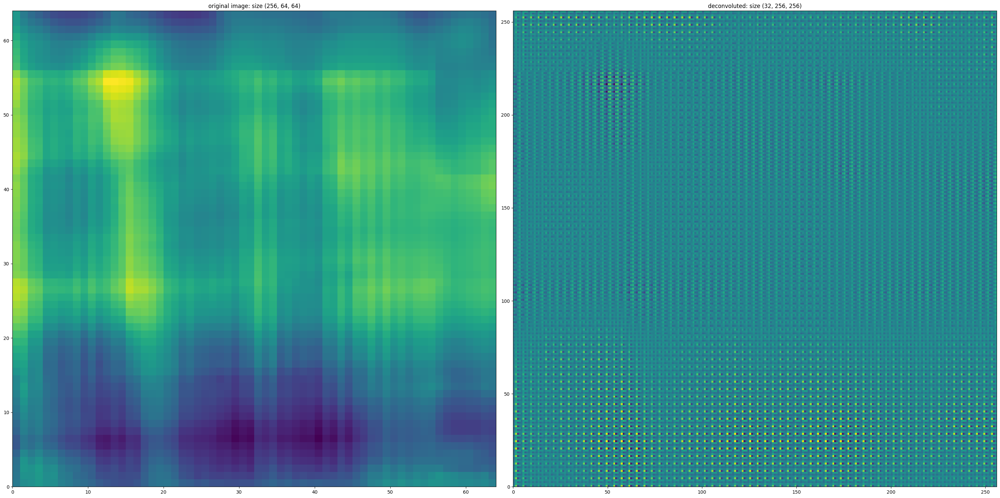

In [ ]:
# try to recreate the original pattern by applying a deconvolution similar to that in sam's mask_decoder

class LayerNorm2d(torch.nn.Module):
  def __init__(self, num_channels: int, eps: float = 1e-6) -> None:
    super().__init__()
    self.weight = torch.nn.Parameter(torch.ones(num_channels))
    self.bias = torch.nn.Parameter(torch.zeros(num_channels))
    self.eps = eps

  def forward(self, x: torch.Tensor) -> torch.Tensor:
    u = x.mean(1, keepdim=True)
    s = (x - u).pow(2).mean(1, keepdim=True)
    x = (x - u) / torch.sqrt(s + self.eps)
    x = self.weight[:, None, None] * x + self.bias[:, None, None]
    return x

transformer_dim = 256
activation = torch.nn.GELU

#output_upscaling = torch.nn.Sequential(
#            torch.nn.ConvTranspose2d(1, 1, kernel_size=4, stride=2, padding=1),
#            torch.nn.ConvTranspose2d(1, 1, kernel_size=4, stride=2, padding=1),
#       )

output_upscaling = model.sam_model.mask_decoder.output_upscaling

# set the weights to the model's learned mask
weights0 = model.sam_model.mask_decoder.output_upscaling[0].weight.data
weights1 = model.sam_model.mask_decoder.output_upscaling[1].weight.data
print(f"weights 0 shape: {weights0.shape}")
print(f"weights 1 shape: {weights1.shape}")

src = pooled2[0].squeeze().detach().cpu().unsqueeze(0)
src = src.repeat(transformer_dim, 1, 1)
print(f"src shape: {src.shape}")
upscaled = output_upscaling(src.to(device)).detach().cpu()
print(f"upscaled shape: {upscaled.shape}")

fig, axs = plt.subplots(1,2, figsize=(30,15))
axs[0].pcolormesh(src[0].squeeze())
axs[0].set_title(f'original image: size {tuple(src.shape)}')
axs[1].pcolormesh(upscaled[0].squeeze())
axs[1].set_title(f'deconvoluted: size {tuple(upscaled.shape)}')

plt.tight_layout()
plt.show()

In [ ]:
256*64*64

1048576

This attempt is a sort of filtering I perform on the mask, which seems to display a repeating pattern of 4x4 pixel patterns, no matter what the input. To apply a pooling with a (4,4) kernel size and stride of 4 on the predicted mask removes the repeating pixel pattern, but also reduces the resolution of the predicted mask to (64, 64).

An experiment to see the result of a deconvolution operation, example in the figure above, shows the similar patterning done to the the image. Note, that the weights of the devonvolution being random adds a very noisy character to the result. This suggested that there is an upscaling operation done internally to the SAM mask decoder which may be introducing these repeated artifacts.

Indeed, looking into the repository we see that the output of the transformer block in the mask decoder is run through a channel dimension reducing / resolution increasing upscaling operation, from the channel dimension of the transformer (256) to the dimension of the mask (32x256x256). This corresponds to a 2-fold increase in total data.



```

self.output_upscaling = nn.Sequential(
            nn.ConvTranspose2d(transformer_dim, transformer_dim // 4, kernel_size=2, stride=2),
            LayerNorm2d(transformer_dim // 4),
            activation(),
            nn.ConvTranspose2d(transformer_dim // 4, transformer_dim // 8, kernel_size=2, stride=2),
            activation(),
        )
```



In [ ]:
32*256*256

2097152

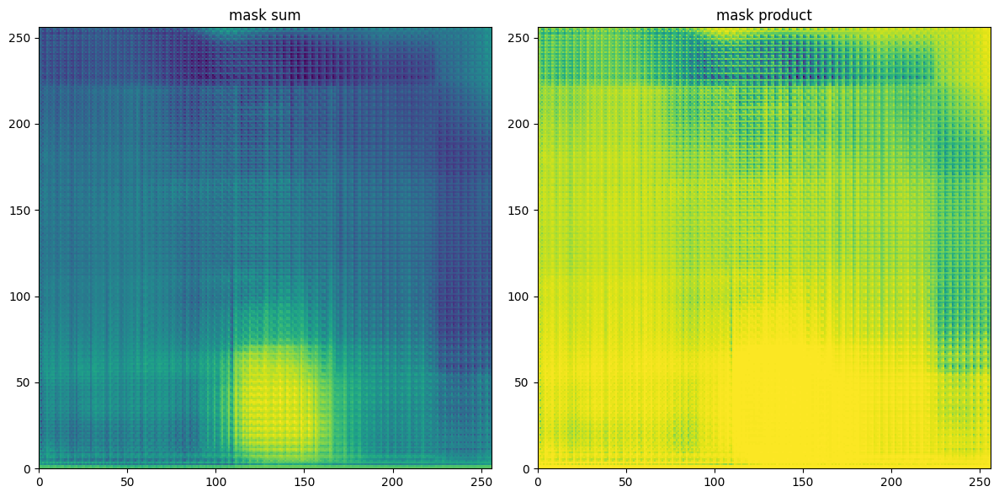

In [ ]:
# plot combinations of masks
mask_sum = torch.sum(pred_mask, dim=0)
mask_product = pred_mask[0] * pred_mask[1] * pred_mask[2]
fig, axs = plt.subplots(1,2, figsize=(12,6))
axs[0].pcolormesh(mask_sum.detach().cpu())
axs[0].set_title('mask sum')
axs[1].pcolormesh(mask_product.detach().cpu())
axs[1].set_title('mask product')
plt.tight_layout()
plt.show()

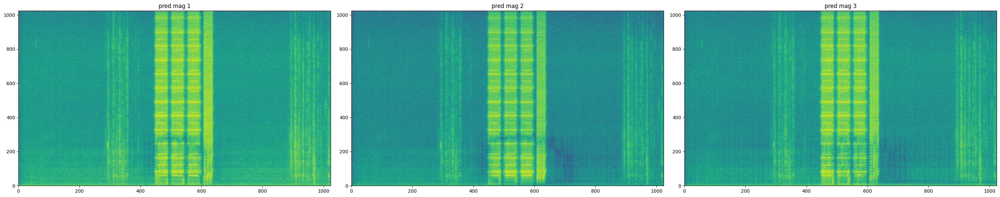

In [ ]:
# plot predicted audio spectrum:
fig, axs = plt.subplots(1, 3, figsize=(30,6))

axs[0].pcolormesh(10*torch.log10(pred_spec.squeeze()[0]).detach().cpu())
axs[0].set_title('pred mag 1')

axs[1].pcolormesh(10*torch.log10(pred_spec.squeeze()[1]).detach().cpu())
axs[1].set_title('pred mag 2')

axs[2].pcolormesh(10*torch.log10(pred_spec.squeeze()[2]).detach().cpu())
axs[2].set_title('pred mag 3')
plt.tight_layout()
plt.show()

In [ ]:
import IPython
sr = model.sample_rate
print("mix")
IPython.display.display(IPython.display.Audio(mix, rate=sr))

print("long")
IPython.display.display(IPython.display.Audio(longer_audio, rate=sr))

print("padded")

IPython.display.display(IPython.display.Audio(padded_audio, rate=sr))

mix


long


/usr/local/lib/python3.10/dist-packages/IPython/lib/display.py:174: RuntimeWarning: invalid value encountered in true_divide
  scaled = data / normalization_factor * 32767


padded


# Train

## Define Training & Testing loops

In [ ]:
#### Define Training and Testing Loops:

from tqdm.auto import tqdm
from segsep.utils import should_skip_chunk
from torch.utils.data import SubsetRandomSampler

# --------------------------------------------------------------------------------------------------
def _train(model, dataloader, optimizer, loss_fn, acc_fn, device, upscale_mask=False, verbose=False):
  model.train()
  epoch_loss = 0
  epoch_acc = 0

  # automatic mixed precision scaler:
  scaler = torch.cuda.amp.GradScaler()

  # choose chunks of audio of chunk_size samples such that
  # each chunk results in a STFT of model.spec_dim[0] time bins
  hop_len = model.hop_length
  hop_cnt = model.spec_dim[0]
  chunk_size = model.input_chunk_size
  print(f"choosing audio of {chunk_size} samples -> {chunk_size/model.resample_rate:.5f}s")

  for idx, (mix_audio, source_audio) in enumerate(tqdm(dataloader)):
    optimizer.zero_grad()
    # add a 3rd channel to each audio tensor:
    if source_audio.shape[1] == 2:
      source_audio_ch3=(source_audio[:,0]-source_audio[:,1]).unsqueeze(0)
      source_audio = torch.cat((source_audio, source_audio_ch3), dim=1)
    elif source_audio.shape[1] == 1:
        source_audio = torch.cat((source_audio, source_audio, source_audio), dim=1)
    if mix_audio.shape[1] == 2:
      mix_audio_ch3=(mix_audio[:,0]-mix_audio[:,1]).unsqueeze(0)
      mix_audio = torch.cat((mix_audio, mix_audio_ch3), dim=1)
    elif mix_audio.shape[1] == 1:
      mix_audio = torch.cat((mix_audio, mix_audio, mix_audio), dim=1)


    track_loss = 0
    track_acc = 0
    chunk_cnt = 0
    skip_chunk_cnt = 0
    sample_cnt = mix_audio.shape[2] # [batch, channel, audio]

    mix_audio = mix_audio.squeeze().to(device)
    source_audio = source_audio.squeeze().to(device)
    # omit last chunk if its size would be less than chunk_size
    for start_idx in range(0, sample_cnt-chunk_size+1, chunk_size):
      end_idx = start_idx + chunk_size
      mix_chunk = mix_audio[:, start_idx:end_idx]
      source_chunk = source_audio[:, start_idx:end_idx]
      #print(f"doing idx {start_idx}:{end_idx} - {float(end_idx)/mix_audio_3.shape[1]:.3f}")

      if should_skip_chunk(mix_chunk) or should_skip_chunk(source_chunk):
        skip_chunk_cnt += 1
        continue

      #print(f"mix chunk shape {mix_chunk.shape}")
      if torch.isnan(mix_chunk).any():
        print("input data contains nan!")
        mix_chunk = torch.nan_to_num(mix_chunk)

      # context for automatic mixed precision
      with torch.cuda.amp.autocast():
        pred_audio, mix_spec_in, phase_in, pred_mag, upscaled_pred_mask, iou_scores = model(audio_in=mix_chunk,
                                                                                            upscale_mask=upscale_mask,
                                                                                            debug=verbose)

        if torch.isnan(pred_audio).any():
          print("prediction contains nan!")
          continue
          #pred_audio = torch.nan_to_num(pred_audio)

        trim_idx = min(pred_audio.shape[1], source_chunk.shape[1])

        # calculate loss/acc on SPEC
        source_spec = torch.abs(model.encoder(source_chunk))
        loss = loss_fn(pred_mag.squeeze(), source_spec)
        acc = acc_fn(pred_mag, source_spec)

      epoch_loss += loss.item()
      track_loss += loss.item()

      epoch_acc += acc.item()
      track_acc += acc.item()
      chunk_cnt += 1

      # traditional backward pass
      #loss.backward()
      #optimizer.step()

      # backward pass with automatic mixed precision
      scaler.scale(loss).backward()
      scaler.step(optimizer)
      scaler.update()

      del pred_audio
      del loss
      del acc

    del mix_audio
    del source_audio

    torch.cuda.empty_cache()
    if verbose:
      print(f"TRAIN track {idx}/{len(dataloader)} loss: {track_loss}, track acc: {track_acc:.4f}, skip chunk cnt: {skip_chunk_cnt}/{chunk_cnt}")
  return epoch_loss / len(dataloader), epoch_acc / len(dataloader)

# --------------------------------------------------------------------------------------------------
def _validate(model, dataloader, loss_fn, acc_fn, device, subset_proportion=0.1, upscale_mask=False, verbose=False):
  model.eval()
  epoch_loss = 0
  epoch_acc = 0

  with torch.inference_mode():

    subset_sample_cnt = int(len(dataloader) * subset_proportion)
    subset_indices = torch.randperm(len(dataloader))[:subset_sample_cnt]
    subset_sampler = SubsetRandomSampler(subset_indices)
    subset_dataloader = torch.utils.data.DataLoader(dataloader.dataset,
                                                    batch_size=dataloader.batch_size,
                                                    sampler=subset_sampler,
                                                    num_workers=dataloader.num_workers,
                                                    pin_memory=dataloader.pin_memory)

    # choose chunks of audio of chunk_size samples such that
    # each chunk results in a STFT of model.spec_dim[0] time bins
    hop_len = model.hop_length
    hop_cnt = model.spec_dim[0]
    chunk_size = model.input_chunk_size

    #print(f"choosing audio of {chunk_size} samples -> {chunk_size/model.resample_rate:.5f}s")

    for idx, (mix_audio, source_audio) in enumerate(tqdm(subset_dataloader)):
      # add a 3rd channel to each audio tensor:
      if source_audio.shape[1] == 2:
        source_audio_ch3=(source_audio[:,0]-source_audio[:,1]).unsqueeze(0)
        source_audio = torch.cat((source_audio, source_audio_ch3), dim=1)
      elif source_audio.shape[1] == 1:
          source_audio = torch.cat((source_audio, source_audio, source_audio), dim=1)
      if mix_audio.shape[1] == 2:
        mix_audio_ch3=(mix_audio[:,0]-mix_audio[:,1]).unsqueeze(0)
        mix_audio = torch.cat((mix_audio, mix_audio_ch3), dim=1)
      elif mix_audio.shape[1] == 1:
        mix_audio = torch.cat((mix_audio, mix_audio, mix_audio), dim=1)

      track_loss = 0
      track_acc = 0
      chunk_cnt = 0
      skip_chunk_cnt = 0
      sample_cnt = mix_audio.shape[2] # [batch, channel, audio]

      mix_audio = mix_audio.squeeze().to(device)
      source_audio = source_audio.squeeze().to(device)
      # omit last chunk if its size would be less than chunk_size
      for start_idx in range(0, sample_cnt-chunk_size+1, chunk_size):
        end_idx = start_idx + chunk_size
        mix_chunk = mix_audio[:, start_idx:end_idx]
        source_chunk = source_audio[:, start_idx:end_idx]
        #print(f"doing idx {start_idx}:{end_idx} - {float(end_idx)/mix_audio.shape[1]:.3f}")

        if should_skip_chunk(mix_chunk) or should_skip_chunk(source_chunk):
          skip_chunk_cnt += 1
          continue

        #print(f"mix chunk shape {mix_chunk.shape}")
        if torch.isnan(mix_chunk).any():
          print("input data contains nan!")
          continue
          #mix_chunk = torch.nan_to_num(mix_chunk)
        pred_audio, mix_spec_in, phase_in, pred_mag, upscaled_pred_mask, iou_scores = model(audio_in=mix_chunk,
                                                                                            upscale_mask=upscale_mask)
        if torch.isnan(pred_audio).any():
          print("predicted audio contains nan!")
          continue
        trim_idx = min(pred_audio.shape[1], source_chunk.shape[1])

        # calculate loss/acc on SPEC
        source_spec = torch.abs(model.encoder(source_chunk))
        loss = loss_fn(pred_mag.squeeze(), source_spec)
        acc = acc_fn(pred_mag, source_spec)

        epoch_loss += loss.item()
        track_loss += loss.item()

        epoch_acc += acc.item()
        track_acc += acc.item()

        chunk_cnt += 1

        # madre mia
        del pred_audio
        del loss
      del mix_audio
      del source_audio
      torch.cuda.empty_cache()
      if verbose:
        print(f"TEST track {idx}/{len(subset_dataloader)} loss: {track_loss:.8f}, track acc: {track_acc:.4f}, skip chunk cnt: {skip_chunk_cnt}/{chunk_cnt}")
  return epoch_loss / len(subset_dataloader), epoch_acc / len(subset_dataloader)

## Load the model anew

In [ ]:
# reload model
model = SamWrapper2(spec_dim=(1024,1024),
                   sample_rate=44100,
                   resample_rate=22050).to(device)

## Freeze parameters

In [ ]:
# Freeze parameters
for name, param in model.sam_model.named_parameters():
  if name.startswith("image_encoder"): # a.k.a. "vision_encoder" in HuggingFace version
    param.requires_grad_(False)
  elif name.startswith("prompt_encoder"):
    param.requires_grad_(False)
  elif name.startswith("mask_decoder"):
    param.requires_grad_(True)


## Model info

In [ ]:
summary(model=model,
        input_size=(3, model.input_chunk_size),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                                                Input Shape          Output Shape         Param #              Trainable
SamWrapper2 (SamWrapper2)                                              [3, 521730]          [3, 521730]          --                   Partial
├─Resample (downsampler)                                               [3, 521730]          [3, 260865]          --                   --
├─Sam (sam_model)                                                      --                   --                   --                   Partial
│    └─ImageEncoderViT (image_encoder)                                 [1, 3, 1024, 1024]   [1, 256, 64, 64]     5,242,880            False
│    │    └─PatchEmbed (patch_embed)                                   [1, 3, 1024, 1024]   [1, 64, 64, 1280]    (984,320)            False
│    │    └─ModuleList (blocks)                                        --                   --                   (629,880,320)        False
│    │    └─Seq

Initialize tracking stats, instantiate optimizer

In [ ]:
# Initialize stats tracking ONLY if not loading new model!
train_losses = []
test_losses = []
train_accs = []
test_accs = []

In [ ]:
best_test_loss = float('inf')
best_train_loss = float('inf')


In [ ]:
# Set trainable parameters
learning_rate = 1e-5
#trainable_parameters = list(model.sam_model.mask_decoder.parameters()) + list (model.sam_model.vision_encoder.parameters())
#trainable_parameters = list(model.sam_model.vision_encoder.parameters())
trainable_parameters = list(model.sam_model.mask_decoder.parameters())
#trainable_parameters = list(model.sam_model.mask_decoder.parameters()) + list (model.sam_model.image_encoder.parameters())
optimizer = torch.optim.Adam(trainable_parameters, lr=learning_rate, weight_decay=0)


## Set model name, start the training

In [ ]:
###. trainin' it

train_audio_metadata_json="dev_audio_metadata.json"
test_audio_metadata_json="eval_audio_metadata.json"
fsd_train_location="/content/FSD50K.dev_audio"
fsd_test_location="/content/FSD50K.eval_audio"

model_name = "SAM2_mask_decoder_finetune_run_17"

centroid_diff_hz = 3000.0

train_dataset = AudioPairDataset(audio_dir=fsd_train_location,
                                json_path=train_audio_metadata_json,
                                centroid_diff_hz=centroid_diff_hz,
                                min_duration_s=11.5,#model.input_chunk_size/model.resample_rate,
                                dummy_mode=False)

test_dataset = AudioPairDataset(audio_dir=fsd_test_location,
                                json_path=test_audio_metadata_json,
                                centroid_diff_hz=centroid_diff_hz,
                                min_duration_s=11.5,# model.input_chunk_size/model.resample_rate,
                                dummy_mode=False)

train_dataloader = torch.utils.data.DataLoader(dataset=train_dataset,
                                                batch_size=1,
                                                num_workers=3,
                                                shuffle=True)

test_dataloader = torch.utils.data.DataLoader(dataset=test_dataset,
                                                batch_size=1,
                                                num_workers=3,
                                                shuffle=True)


# tracking best loss for stopping condition

patience = 10 # epochs to tolerate lack of improvement
no_improve_counter = 0 # counter to track lack of improvement

num_epochs = 199
# Training and validation loop
for epoch in range(num_epochs):
  print(f"starting epoch {epoch}")
  # Training

  train_loss, train_acc = _train(model=model,
                                dataloader=train_dataloader,
                                optimizer=optimizer,
                                loss_fn=LOGL2loss_freq,
                                acc_fn=si_snr,
                                device=device,
                                upscale_mask=True,
                                verbose=False)

  mean_train_loss = 0 if len(train_losses) == 0 else mean(train_losses)
  mean_train_acc = 0 if len(train_accs) == 0 else mean(train_accs)

  if train_loss < best_train_loss:
    print(f"~~~Best Train loss! {train_loss} <- {best_train_loss}; delta {best_train_loss-train_loss}")
    best_train_loss = train_loss

  delta_loss = train_loss - mean_train_loss
  delta_acc = train_acc - mean_train_acc

  print(f"epoch {epoch} train done -> avg train_loss: {train_loss:.5e} (delta {delta_loss:.5e}), acc: {train_acc:.5e} (delta {delta_acc:.5e})")
  train_losses.append(train_loss)
  train_accs.append(train_acc)

  print(f"mean train_loss so far: {mean(train_losses):.5e}, acc: {mean(train_accs):.5e}")

  # Validation
  test_loss, test_acc = _validate(model=model,
                                  dataloader=test_dataloader,
                                  loss_fn=LOGL2loss_freq,
                                  acc_fn=si_snr,
                                  device=device,
                                  subset_proportion=0.8,
                                  upscale_mask=True,
                                  verbose=False)



  mean_test_loss = 0 if len(test_losses) == 0 else mean(test_losses)
  mean_test_acc = 0 if len(test_accs) == 0 else mean(test_accs)
  delta_loss = test_loss - mean_test_loss
  delta_acc = test_acc - mean_test_acc
  print(f"epoch {epoch} test done -> avg test_loss: {test_loss:.5e} (delta {delta_loss:.5e}), acc: {test_acc:.5e} (delta {delta_acc:.5e})")
  test_losses.append(test_loss)
  test_accs.append(test_acc)
  print(f"mean test_loss so far: {mean(test_losses):.5e}, acc: {mean(test_accs):.5e}")

  # Print stats
  print(f"Epoch {epoch+1}/{num_epochs}:")
  print(f"Train Loss: {train_loss:.5e}, Train Acc: {train_acc:.5e}")
  print(f"Test Loss: {test_loss:.5e}, Test Acc: {test_acc:.5e}")

  if test_loss < best_test_loss:
    print(f"~~~~~~~~~New Best Test Loss! {test_loss:.5e} <- {best_test_loss:.5e} (delta: {test_loss-best_test_loss:.5e})")
    best_test_loss = test_loss
    no_improve_counter = 0

    # save best model
    now = datetime.now()
    date_time = now.strftime("%m-%d-%y_%H:%M:%S")
    loss_name="LOGL2loss_freq"
    checkpoint_path = f'/content/drive/MyDrive/models/best_{model_name}-{loss_name}-lr_{learning_rate}.pth'
    print(f"SAVING checkpoint: {checkpoint_path}")
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'best_test_loss': best_test_loss,
        'train_loss': train_losses,
        'test_loss': test_losses,
        'train_acc': train_accs,
        'test_acc': test_accs,
        'save_time': date_time
          }, checkpoint_path)

    #hack: save a dummy file with some info in the name so i can see it without being there
    info_path = f'/content/drive/MyDrive/models/new_best_{date_time}-{model_name}-{loss_name}-lr_{learning_rate}.pth'
    torch.save(0, info_path)

  else:
    no_improve_counter += 1
    print(f"no improvement, counter at: {no_improve_counter}")

    #hack: save a dummy file with some info in the name so i can see it without being there
    now = datetime.now()
    date_time = now.strftime("%m-%d-%y_%H:%M:%S")
    info_path = f'/content/drive/MyDrive/models/no_improvement_cnt_{no_improve_counter}_epoch_{epoch}_{date_time}-{model_name}-{loss_name}-lr_{learning_rate}.pth'
    torch.save(0, info_path)


  if no_improve_counter > patience:
    print("Early stopping due to no improvement!")

    #hack: save a dummy file with some info in the name so i can see it without being there
    now = datetime.now()
    date_time = now.strftime("%m-%d-%y_%H:%M:%S")
    loss_name="LOGL2loss_freq"
    info_path = f'/content/drive/MyDrive/models/STOPPED_EARLY_{model_name}-{loss_name}-lr_{learning_rate}.pth'
    torch.save({
        'epoch': epoch,
        'train_loss': train_losses,
        'test_loss': test_losses
      }, info_path)
    break

  if (epoch + 1) % 5 == 0:
  # save intermediate checkpoint anyway
    now = datetime.now()
    date_time = now.strftime("%m-%d-%y_%H:%M:%S")
    loss_name="LOGL2loss_freq"
    checkpoint_path = f'/content/drive/MyDrive/models/intermediate_epoch_{epoch}_{model_name}-{loss_name}-lr_{learning_rate}.pth'
    print(f"SAVING checkpoint: {checkpoint_path}")
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'best_test_loss': best_test_loss,
        'train_loss': train_losses,
        'test_loss': test_losses,
        'train_acc': train_accs,
        'test_acc': test_accs,
        'save_time': date_time
          }, checkpoint_path)

found 8325 files of length 11.5s or longer
found 3514 files of length 11.5s or longer
starting epoch 0
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

~~~Best Train loss! 9.980089432298934e-06 <- inf; delta inf
epoch 0 train done -> avg train_loss: 9.98009e-06 (delta 9.98009e-06), acc: -7.62021e+00 (delta -7.62021e+00)
mean train_loss so far: 9.98009e-06, acc: -7.62021e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 0 test done -> avg test_loss: 1.12466e-05 (delta 1.12466e-05), acc: -2.73169e+00 (delta -2.73169e+00)
mean test_loss so far: 1.12466e-05, acc: -2.73169e+00
Epoch 1/199:
Train Loss: 9.98009e-06, Train Acc: -7.62021e+00
Test Loss: 1.12466e-05, Test Acc: -2.73169e+00
~~~~~~~~~New Best Test Loss! 1.12466e-05 <- inf (delta: -inf)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM2_mask_decoder_finetune_run_17-LOGL2loss_freq-lr_1e-05.pth
starting epoch 1
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

~~~Best Train loss! 9.437978723826335e-06 <- 9.980089432298934e-06; delta 5.421107084725992e-07
epoch 1 train done -> avg train_loss: 9.43798e-06 (delta -5.42111e-07), acc: -7.71199e+00 (delta -9.17795e-02)
mean train_loss so far: 9.70903e-06, acc: -7.66610e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 1 test done -> avg test_loss: 1.04492e-05 (delta -7.97425e-07), acc: -1.02091e+01 (delta -7.47739e+00)
mean test_loss so far: 1.08479e-05, acc: -6.47038e+00
Epoch 2/199:
Train Loss: 9.43798e-06, Train Acc: -7.71199e+00
Test Loss: 1.04492e-05, Test Acc: -1.02091e+01
~~~~~~~~~New Best Test Loss! 1.04492e-05 <- 1.12466e-05 (delta: -7.97425e-07)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM2_mask_decoder_finetune_run_17-LOGL2loss_freq-lr_1e-05.pth
starting epoch 2
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

~~~Best Train loss! 9.326296114724958e-06 <- 9.437978723826335e-06; delta 1.1168260910137718e-07
epoch 2 train done -> avg train_loss: 9.32630e-06 (delta -3.82738e-07), acc: -6.94542e+00 (delta 7.20681e-01)
mean train_loss so far: 9.58145e-06, acc: -7.42587e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 2 test done -> avg test_loss: 1.04410e-05 (delta -4.06930e-07), acc: -1.46657e+01 (delta -8.19528e+00)
mean test_loss so far: 1.07123e-05, acc: -9.20214e+00
Epoch 3/199:
Train Loss: 9.32630e-06, Train Acc: -6.94542e+00
Test Loss: 1.04410e-05, Test Acc: -1.46657e+01
~~~~~~~~~New Best Test Loss! 1.04410e-05 <- 1.04492e-05 (delta: -8.21794e-09)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM2_mask_decoder_finetune_run_17-LOGL2loss_freq-lr_1e-05.pth
starting epoch 3
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

~~~Best Train loss! 9.226604869398942e-06 <- 9.326296114724958e-06; delta 9.969124532601576e-08
epoch 3 train done -> avg train_loss: 9.22660e-06 (delta -3.54850e-07), acc: -6.51083e+00 (delta 9.15044e-01)
mean train_loss so far: 9.49274e-06, acc: -7.19711e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 3 test done -> avg test_loss: 1.05768e-05 (delta -1.35431e-07), acc: -2.13849e+01 (delta -1.21828e+01)
mean test_loss so far: 1.06784e-05, acc: -1.22478e+01
Epoch 4/199:
Train Loss: 9.22660e-06, Train Acc: -6.51083e+00
Test Loss: 1.05768e-05, Test Acc: -2.13849e+01
no improvement, counter at: 1
starting epoch 4
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

~~~Best Train loss! 9.145738824793137e-06 <- 9.226604869398942e-06; delta 8.086604460580517e-08
epoch 4 train done -> avg train_loss: 9.14574e-06 (delta -3.47003e-07), acc: -6.97058e+00 (delta 2.26526e-01)
mean train_loss so far: 9.42334e-06, acc: -7.15180e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 4 test done -> avg test_loss: 1.05608e-05 (delta -1.17547e-07), acc: -2.37329e+00 (delta 9.87454e+00)
mean test_loss so far: 1.06549e-05, acc: -1.02729e+01
Epoch 5/199:
Train Loss: 9.14574e-06, Train Acc: -6.97058e+00
Test Loss: 1.05608e-05, Test Acc: -2.37329e+00
no improvement, counter at: 2
SAVING checkpoint: /content/drive/MyDrive/models/intermediate_epoch_4_SAM2_mask_decoder_finetune_run_17-LOGL2loss_freq-lr_1e-05.pth
starting epoch 5
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

epoch 5 train done -> avg train_loss: 9.20675e-06 (delta -2.16595e-07), acc: -6.68160e+00 (delta 4.70201e-01)
mean train_loss so far: 9.38724e-06, acc: -7.07344e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 5 test done -> avg test_loss: 1.04682e-05 (delta -1.86665e-07), acc: -4.87572e+00 (delta 5.39721e+00)
mean test_loss so far: 1.06238e-05, acc: -9.37339e+00
Epoch 6/199:
Train Loss: 9.20675e-06, Train Acc: -6.68160e+00
Test Loss: 1.04682e-05, Test Acc: -4.87572e+00
no improvement, counter at: 3
starting epoch 6
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

~~~Best Train loss! 9.125481193132966e-06 <- 9.145738824793137e-06; delta 2.0257631660171318e-08
epoch 6 train done -> avg train_loss: 9.12548e-06 (delta -2.61761e-07), acc: -7.13796e+00 (delta -6.45239e-02)
mean train_loss so far: 9.34985e-06, acc: -7.08265e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 6 test done -> avg test_loss: 1.02223e-05 (delta -4.01506e-07), acc: -6.60571e+00 (delta 2.76769e+00)
mean test_loss so far: 1.05664e-05, acc: -8.97801e+00
Epoch 7/199:
Train Loss: 9.12548e-06, Train Acc: -7.13796e+00
Test Loss: 1.02223e-05, Test Acc: -6.60571e+00
~~~~~~~~~New Best Test Loss! 1.02223e-05 <- 1.04410e-05 (delta: -2.18697e-07)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM2_mask_decoder_finetune_run_17-LOGL2loss_freq-lr_1e-05.pth
starting epoch 7
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

epoch 7 train done -> avg train_loss: 9.16402e-06 (delta -1.85828e-07), acc: -6.48151e+00 (delta 6.01147e-01)
mean train_loss so far: 9.32662e-06, acc: -7.00751e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 7 test done -> avg test_loss: 1.03479e-05 (delta -2.18498e-07), acc: -3.39259e+00 (delta 5.58542e+00)
mean test_loss so far: 1.05391e-05, acc: -8.27983e+00
Epoch 8/199:
Train Loss: 9.16402e-06, Train Acc: -6.48151e+00
Test Loss: 1.03479e-05, Test Acc: -3.39259e+00
no improvement, counter at: 1
starting epoch 8
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

~~~Best Train loss! 9.068067245678393e-06 <- 9.125481193132966e-06; delta 5.741394745457247e-08
epoch 8 train done -> avg train_loss: 9.06807e-06 (delta -2.58552e-07), acc: -6.93794e+00 (delta 6.95694e-02)
mean train_loss so far: 9.29789e-06, acc: -6.99978e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 8 test done -> avg test_loss: 1.03176e-05 (delta -2.21493e-07), acc: -1.28965e+01 (delta -4.61665e+00)
mean test_loss so far: 1.05145e-05, acc: -8.79279e+00
Epoch 9/199:
Train Loss: 9.06807e-06, Train Acc: -6.93794e+00
Test Loss: 1.03176e-05, Test Acc: -1.28965e+01
no improvement, counter at: 2
starting epoch 9
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

epoch 9 train done -> avg train_loss: 9.12095e-06 (delta -1.76946e-07), acc: -6.50901e+00 (delta 4.90774e-01)
mean train_loss so far: 9.28020e-06, acc: -6.95070e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 9 test done -> avg test_loss: 1.01989e-05 (delta -3.15614e-07), acc: -7.93766e+00 (delta 8.55132e-01)
mean test_loss so far: 1.04829e-05, acc: -8.70728e+00
Epoch 10/199:
Train Loss: 9.12095e-06, Train Acc: -6.50901e+00
Test Loss: 1.01989e-05, Test Acc: -7.93766e+00
~~~~~~~~~New Best Test Loss! 1.01989e-05 <- 1.02223e-05 (delta: -2.33885e-08)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM2_mask_decoder_finetune_run_17-LOGL2loss_freq-lr_1e-05.pth
SAVING checkpoint: /content/drive/MyDrive/models/intermediate_epoch_9_SAM2_mask_decoder_finetune_run_17-LOGL2loss_freq-lr_1e-05.pth
starting epoch 10
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

~~~Best Train loss! 8.972731027568186e-06 <- 9.068067245678393e-06; delta 9.533621811020708e-08
epoch 10 train done -> avg train_loss: 8.97273e-06 (delta -3.07466e-07), acc: -6.85102e+00 (delta 9.96857e-02)
mean train_loss so far: 9.25225e-06, acc: -6.94164e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 10 test done -> avg test_loss: 1.04025e-05 (delta -8.04802e-08), acc: -1.17577e+01 (delta -3.05040e+00)
mean test_loss so far: 1.04756e-05, acc: -8.98459e+00
Epoch 11/199:
Train Loss: 8.97273e-06, Train Acc: -6.85102e+00
Test Loss: 1.04025e-05, Test Acc: -1.17577e+01
no improvement, counter at: 1
starting epoch 11
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

epoch 11 train done -> avg train_loss: 9.09606e-06 (delta -1.56186e-07), acc: -6.10893e+00 (delta 8.32710e-01)
mean train_loss so far: 9.23923e-06, acc: -6.87225e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 11 test done -> avg test_loss: 1.01142e-05 (delta -3.61454e-07), acc: -1.51380e+01 (delta -6.15342e+00)
mean test_loss so far: 1.04455e-05, acc: -9.49738e+00
Epoch 12/199:
Train Loss: 9.09606e-06, Train Acc: -6.10893e+00
Test Loss: 1.01142e-05, Test Acc: -1.51380e+01
~~~~~~~~~New Best Test Loss! 1.01142e-05 <- 1.01989e-05 (delta: -8.47181e-08)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM2_mask_decoder_finetune_run_17-LOGL2loss_freq-lr_1e-05.pth
starting epoch 12
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

epoch 12 train done -> avg train_loss: 9.11141e-06 (delta -1.27818e-07), acc: -6.72718e+00 (delta 1.45068e-01)
mean train_loss so far: 9.22940e-06, acc: -6.86109e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 12 test done -> avg test_loss: 1.03464e-05 (delta -9.91285e-08), acc: -8.23442e+00 (delta 1.26295e+00)
mean test_loss so far: 1.04379e-05, acc: -9.40022e+00
Epoch 13/199:
Train Loss: 9.11141e-06, Train Acc: -6.72718e+00
Test Loss: 1.03464e-05, Test Acc: -8.23442e+00
no improvement, counter at: 1
starting epoch 13
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

epoch 13 train done -> avg train_loss: 9.12645e-06 (delta -1.02948e-07), acc: -6.03846e+00 (delta 8.22633e-01)
mean train_loss so far: 9.22204e-06, acc: -6.80233e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 13 test done -> avg test_loss: 1.02834e-05 (delta -1.54449e-07), acc: -5.69960e+00 (delta 3.70063e+00)
mean test_loss so far: 1.04268e-05, acc: -9.13589e+00
Epoch 14/199:
Train Loss: 9.12645e-06, Train Acc: -6.03846e+00
Test Loss: 1.02834e-05, Test Acc: -5.69960e+00
no improvement, counter at: 2
starting epoch 14
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

epoch 14 train done -> avg train_loss: 9.08812e-06 (delta -1.33923e-07), acc: -6.17609e+00 (delta 6.26242e-01)
mean train_loss so far: 9.21312e-06, acc: -6.76058e+00


  0%|          | 0/2811 [00:00<?, ?it/s]

epoch 14 test done -> avg test_loss: 1.03570e-05 (delta -6.98543e-08), acc: -6.83202e+00 (delta 2.30388e+00)
mean test_loss so far: 1.04222e-05, acc: -8.98230e+00
Epoch 15/199:
Train Loss: 9.08812e-06, Train Acc: -6.17609e+00
Test Loss: 1.03570e-05, Test Acc: -6.83202e+00
no improvement, counter at: 3
SAVING checkpoint: /content/drive/MyDrive/models/intermediate_epoch_14_SAM2_mask_decoder_finetune_run_17-LOGL2loss_freq-lr_1e-05.pth
starting epoch 15
choosing audio of 521730 samples -> 23.66122s


  0%|          | 0/8325 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

## Save final checkpoint

In [ ]:
now = datetime.now()
date_time = now.strftime("%m-%d-%y_%H:%M:%S")
loss_name="LOGL2loss_freq"
checkpoint_path = f'/content/drive/MyDrive/models/intermediate_epoch_{epoch}_{model_name}-{loss_name}-lr_{learning_rate}.pth'
print(f"SAVING checkpoint: {checkpoint_path}")

torch.save({
    'epoch': epoch,
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'best_test_loss': best_test_loss,
    'train_loss': train_losses,
    'test_loss': test_losses,
    'train_acc': train_accs,
    'test_acc': test_accs,
    'save_time': date_time
      }, checkpoint_path)

SAVING checkpoint: /content/drive/MyDrive/models/intermediate_epoch_15_SAM2_mask_decoder_finetune_run_17-LOGL2loss_freq-lr_1e-05.pth


## plot the loss & accuracy over the course of training

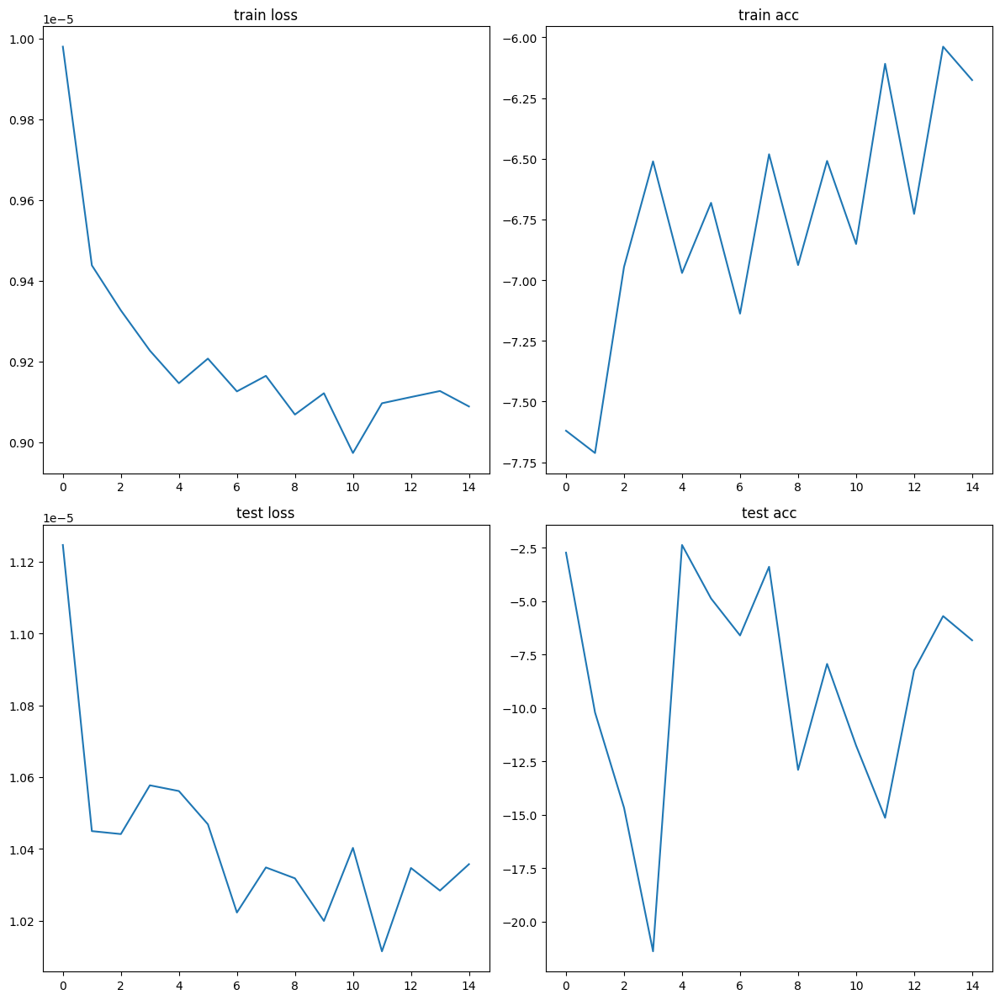

In [ ]:

fig, axs = plt.subplots(2, 2, figsize=(12,12))
axs[0,0].plot(train_losses)
axs[0,0].set_title('train loss')
axs[0,1].plot(train_accs)
axs[0,1].set_title('train acc')
axs[1,0].plot(test_losses)
axs[1,0].set_title('test loss')
axs[1,1].plot(test_accs)
axs[1,1].set_title('test acc')
plt.tight_layout()
plt.show()

In [ ]:
now = datetime.now()
date_time = now.strftime("%m-%d-%y_%H:%M:%S")
print(f"done at {date_time}")

done at 08-27-23_10:32:59


# train mask decoder

In [ ]:
# load saved checkpoint
model = SamWrapper(spec_dim=(256,256),
                   sample_rate=44100,
                   resample_rate=22050,
                   saved_model_state_dict=None).to(device)

# Freeze parameters
for name, param in model.sam_model.named_parameters():
  if name.startswith("vision_encoder"):
    param.requires_grad_(False)
  elif name.startswith("prompt_encoder"):
    param.requires_grad_(False)
  elif name.startswith("mask_decoder"):
    param.requires_grad_(True)




# Initialize stats tracking ONLY if not loading new model!
train_losses = []
test_losses = []
train_accs = []
test_accs = []



learning_rate = 1e-5
best_test_loss = float('inf')
best_train_loss = float('inf')




# Set trainable parameters
#trainable_parameters = list(model.sam_model.mask_decoder.parameters()) + list (model.sam_model.vision_encoder.parameters())
#trainable_parameters = list(model.sam_model.vision_encoder.parameters())
trainable_parameters = list(model.sam_model.mask_decoder.parameters())
optimizer = torch.optim.Adam(trainable_parameters, lr=learning_rate, weight_decay=0)




###. trainin' it

train_audio_metadata_json="dev_audio_metadata.json"
test_audio_metadata_json="eval_audio_metadata.json"
fsd_train_location="/content/FSD50K.dev_audio"
fsd_test_location="/content/FSD50K.eval_audio"

model_name = "SAM_mask_decoder_finetune_run_7"

centroid_diff_hz = 3000.0

train_dataset = AudioPairDataset(audio_dir=fsd_train_location,
                                json_path=train_audio_metadata_json,
                                centroid_diff_hz=centroid_diff_hz,
                                min_duration_s = model.input_chunk_size/model.resample_rate,
                                dummy_mode=False)

test_dataset = AudioPairDataset(audio_dir=fsd_test_location,
                                json_path=test_audio_metadata_json,
                                centroid_diff_hz=centroid_diff_hz,
                                min_duration_s = model.input_chunk_size/model.resample_rate,
                                dummy_mode=False)

train_dataloader = torch.utils.data.DataLoader(dataset=train_dataset,
                                                batch_size=1,
                                                num_workers=0,
                                                shuffle=True)

test_dataloader = torch.utils.data.DataLoader(dataset=test_dataset,
                                                batch_size=1,
                                                num_workers=0,
                                                shuffle=True)


# tracking best loss for stopping condition

patience = 10 # epochs to tolerate lack of improvement
no_improve_counter = 0 # counter to track lack of improvement

num_epochs = 199
# Training and validation loop
for epoch in range(num_epochs):
  print(f"starting epoch {epoch}")
  # Training

  train_loss, train_acc = _train(model=model,
                                dataloader=train_dataloader,
                                optimizer=optimizer,
                                loss_fn=LOGL2loss_freq,
                                acc_fn=si_snr,
                                device=device,
                                verbose=False)

  mean_train_loss = 0 if len(train_losses) == 0 else mean(train_losses)
  mean_train_acc = 0 if len(train_accs) == 0 else mean(train_accs)

  if train_loss < best_train_loss:
    print(f"~~~Best Train loss! {train_loss} <- {best_train_loss}; delta {best_train_loss-train_loss}")
    best_train_loss = train_loss

  delta_loss = train_loss - mean_train_loss
  delta_acc = train_acc - mean_train_acc
  print(f"epoch {epoch} train done -> avg train_loss: {train_loss:.5e} (delta {delta_loss:.5e}), acc: {train_acc:.5e} (delta {delta_acc:.5e})")
  train_losses.append(train_loss)
  train_accs.append(train_acc)

  print(f"mean train_loss so far: {mean(train_losses):.5e}, acc: {mean(train_accs):.5e}")

  # Validation
  test_loss, test_acc = _validate(model=model,
                                  dataloader=test_dataloader,
                                  loss_fn=LOGL2loss_freq,
                                  acc_fn=si_snr,
                                  device=device,
                                  subset_proportion=0.8,
                                  verbose=False)


  if test_loss < best_test_loss:
    print(f"~~~~~~~~~New Best Test Loss! {test_loss:.5e} <- {best_test_loss:.5e} (delta: {test_loss-best_test_loss:.5e})")
    best_test_loss = test_loss
    no_improve_counter = 0

    # save best model
    now = datetime.now()
    date_time = now.strftime("%m-%d-%y_%H:%M:%S")
    loss_name="LOGL2loss_freq"
    checkpoint_path = f'/content/drive/MyDrive/models/best_{model_name}-{loss_name}-lr_{learning_rate}.pth'
    print(f"SAVING checkpoint: {checkpoint_path}")
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'best_test_loss': best_test_loss,
        'train_loss': train_losses,
        'test_loss': test_losses,
        'train_acc': train_accs,
        'test_acc': test_accs,
        'save_time': date_time
          }, checkpoint_path)

    #hack: save a dummy file with some info in the name so i can see it without being there
    info_path = f'/content/drive/MyDrive/models/new_best_{date_time}-{model_name}-{loss_name}-lr_{learning_rate}.pth'
    torch.save(0, info_path)

  else:
    no_improve_counter += 1
    print(f"no improvement, counter at: {no_improve_counter}")

    #hack: save a dummy file with some info in the name so i can see it without being there
    now = datetime.now()
    date_time = now.strftime("%m-%d-%y_%H:%M:%S")
    info_path = f'/content/drive/MyDrive/models/no_improvement_cnt_{no_improve_counter}_epoch_{epoch}_{date_time}-{model_name}-{loss_name}-lr_{learning_rate}.pth'
    torch.save(0, info_path)

  mean_test_loss = 0 if len(test_losses) == 0 else mean(test_losses)
  mean_test_acc = 0 if len(test_accs) == 0 else mean(test_accs)
  delta_loss = test_loss - mean_test_loss
  delta_acc = test_acc - mean_test_acc
  print(f"epoch {epoch} test done -> avg test_loss: {test_loss:.5e} (delta {delta_loss:.5e}), acc: {test_acc:.5e} (delta {delta_acc:.5e})")
  test_losses.append(test_loss)
  test_accs.append(test_acc)
  print(f"mean test_loss so far: {mean(test_losses):.5e}, acc: {mean(test_accs):.5e}")

  # Print stats
  print(f"Epoch {epoch+1}/{num_epochs}:")
  print(f"Train Loss: {train_loss:.5e}, Train Acc: {train_acc:.5e}")
  print(f"Test Loss: {test_loss:.5e}, Test Acc: {test_acc:.5e}")


  if no_improve_counter > patience:
    print("Early stopping due to no improvement!")

    #hack: save a dummy file with some info in the name so i can see it without being there
    now = datetime.now()
    date_time = now.strftime("%m-%d-%y_%H:%M:%S")
    loss_name="LOGL2loss_freq"
    info_path = f'/content/drive/MyDrive/models/STOPPED_EARLY_{model_name}-{loss_name}-lr_{learning_rate}.pth'
    torch.save({
        'epoch': epoch,
        'train_loss': train_losses,
        'test_loss': test_losses
      }, info_path)
    break

  if (epoch + 1) % 5 == 0:
  # save intermediate checkpoint anyway
    now = datetime.now()
    date_time = now.strftime("%m-%d-%y_%H:%M:%S")
    loss_name="LOGL2loss_freq"
    checkpoint_path = f'/content/drive/MyDrive/models/intermediate_epoch_{epoch}_{model_name}-{loss_name}-lr_{learning_rate}.pth'
    print(f"SAVING checkpoint: {checkpoint_path}")
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'best_test_loss': best_test_loss,
        'train_loss': train_losses,
        'test_loss': test_losses,
        'train_acc': train_accs,
        'test_acc': test_accs,
        'save_time': date_time
          }, checkpoint_path)

SamWrapper model n_fft: 2046, win len: 2046, hop len: 255, sample/resample: 2.0 -> input_chunk_size 521730.0
found 2003 files of length 23.66122448979592s or longer
found 913 files of length 23.66122448979592s or longer
starting epoch 0
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.3323394426252284e-05 <- inf; delta inf
epoch 0 train done -> avg train_loss: 1.33234e-05 (delta 1.33234e-05), acc: -1.14594e+01 (delta -1.14594e+01)
mean train_loss so far: 1.33234e-05, acc: -1.14594e+01


  0%|          | 0/730 [00:00<?, ?it/s]

~~~~~~~~~New Best Test Loss! 1.42264e-05 <- inf (delta: -inf)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM_mask_decoder_finetune_run_7-LOGL2loss_freq-lr_1e-05.pth
epoch 0 test done -> avg test_loss: 1.42264e-05 (delta 1.42264e-05), acc: -1.11666e+01 (delta -1.11666e+01)
mean test_loss so far: 1.42264e-05, acc: -1.11666e+01
Epoch 1/199:
Train Loss: 1.33234e-05, Train Acc: -1.14594e+01
Test Loss: 1.42264e-05, Test Acc: -1.11666e+01
starting epoch 1
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.2286657916212723e-05 <- 1.3323394426252284e-05; delta 1.036736510039561e-06
epoch 1 train done -> avg train_loss: 1.22867e-05 (delta -1.03674e-06), acc: -1.13931e+01 (delta 6.63286e-02)
mean train_loss so far: 1.28050e-05, acc: -1.14263e+01


  0%|          | 0/730 [00:00<?, ?it/s]

~~~~~~~~~New Best Test Loss! 1.34326e-05 <- 1.42264e-05 (delta: -7.93846e-07)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM_mask_decoder_finetune_run_7-LOGL2loss_freq-lr_1e-05.pth
epoch 1 test done -> avg test_loss: 1.34326e-05 (delta -7.93846e-07), acc: -1.69285e+01 (delta -5.76185e+00)
mean test_loss so far: 1.38295e-05, acc: -1.40475e+01
Epoch 2/199:
Train Loss: 1.22867e-05, Train Acc: -1.13931e+01
Test Loss: 1.34326e-05, Test Acc: -1.69285e+01
starting epoch 2
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.1950878887593192e-05 <- 1.2286657916212723e-05; delta 3.357790286195309e-07
epoch 2 train done -> avg train_loss: 1.19509e-05 (delta -8.54147e-07), acc: -1.12226e+01 (delta 2.03684e-01)
mean train_loss so far: 1.25203e-05, acc: -1.13584e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 1
epoch 2 test done -> avg test_loss: 1.36090e-05 (delta -2.20507e-07), acc: -6.58342e+00 (delta 7.46412e+00)
mean test_loss so far: 1.37560e-05, acc: -1.15595e+01
Epoch 3/199:
Train Loss: 1.19509e-05, Train Acc: -1.12226e+01
Test Loss: 1.36090e-05, Test Acc: -6.58342e+00
starting epoch 3
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.1924254003684466e-05 <- 1.1950878887593192e-05; delta 2.662488390872621e-08
epoch 3 train done -> avg train_loss: 1.19243e-05 (delta -5.96056e-07), acc: -1.01065e+01 (delta 1.25183e+00)
mean train_loss so far: 1.23713e-05, acc: -1.10454e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 2
epoch 3 test done -> avg test_loss: 1.35370e-05 (delta -2.19021e-07), acc: -1.14912e+01 (delta 6.82912e-02)
mean test_loss so far: 1.37012e-05, acc: -1.15424e+01
Epoch 4/199:
Train Loss: 1.19243e-05, Train Acc: -1.01065e+01
Test Loss: 1.35370e-05, Test Acc: -1.14912e+01
starting epoch 4
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 4 train done -> avg train_loss: 1.20337e-05 (delta -3.37596e-07), acc: -1.01456e+01 (delta 8.99804e-01)
mean train_loss so far: 1.23038e-05, acc: -1.08654e+01


  0%|          | 0/730 [00:00<?, ?it/s]

~~~~~~~~~New Best Test Loss! 1.33735e-05 <- 1.34326e-05 (delta: -5.90542e-08)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM_mask_decoder_finetune_run_7-LOGL2loss_freq-lr_1e-05.pth
epoch 4 test done -> avg test_loss: 1.33735e-05 (delta -3.27719e-07), acc: -1.54853e+01 (delta -3.94287e+00)
mean test_loss so far: 1.36357e-05, acc: -1.23310e+01
Epoch 5/199:
Train Loss: 1.20337e-05, Train Acc: -1.01456e+01
Test Loss: 1.33735e-05, Test Acc: -1.54853e+01
SAVING checkpoint: /content/drive/MyDrive/models/intermediate_epoch_4_SAM_mask_decoder_finetune_run_7-LOGL2loss_freq-lr_1e-05.pth
starting epoch 5
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.1655136037330036e-05 <- 1.1924254003684466e-05; delta 2.6911796635442976e-07
epoch 5 train done -> avg train_loss: 1.16551e-05 (delta -6.48641e-07), acc: -1.13992e+01 (delta -5.33784e-01)
mean train_loss so far: 1.21957e-05, acc: -1.09544e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 1
epoch 5 test done -> avg test_loss: 1.34957e-05 (delta -1.39985e-07), acc: -1.76908e+01 (delta -5.35983e+00)
mean test_loss so far: 1.36124e-05, acc: -1.32243e+01
Epoch 6/199:
Train Loss: 1.16551e-05, Train Acc: -1.13992e+01
Test Loss: 1.34957e-05, Test Acc: -1.76908e+01
starting epoch 6
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 6 train done -> avg train_loss: 1.16625e-05 (delta -5.33135e-07), acc: -1.08493e+01 (delta 1.05083e-01)
mean train_loss so far: 1.21195e-05, acc: -1.09394e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 2
epoch 6 test done -> avg test_loss: 1.34303e-05 (delta -1.82120e-07), acc: -1.24921e+01 (delta 7.32261e-01)
mean test_loss so far: 1.35864e-05, acc: -1.31197e+01
Epoch 7/199:
Train Loss: 1.16625e-05, Train Acc: -1.08493e+01
Test Loss: 1.34303e-05, Test Acc: -1.24921e+01
starting epoch 7
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 7 train done -> avg train_loss: 1.16841e-05 (delta -4.35407e-07), acc: -1.03313e+01 (delta 6.08070e-01)
mean train_loss so far: 1.20651e-05, acc: -1.08634e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 3
epoch 7 test done -> avg test_loss: 1.35295e-05 (delta -5.68319e-08), acc: -1.54330e+01 (delta -2.31327e+00)
mean test_loss so far: 1.35793e-05, acc: -1.34089e+01
Epoch 8/199:
Train Loss: 1.16841e-05, Train Acc: -1.03313e+01
Test Loss: 1.35295e-05, Test Acc: -1.54330e+01
starting epoch 8
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 8 train done -> avg train_loss: 1.20038e-05 (delta -6.12895e-08), acc: -1.01325e+01 (delta 7.30882e-01)
mean train_loss so far: 1.20583e-05, acc: -1.07822e+01


  0%|          | 0/730 [00:00<?, ?it/s]

~~~~~~~~~New Best Test Loss! 1.30971e-05 <- 1.33735e-05 (delta: -2.76412e-07)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM_mask_decoder_finetune_run_7-LOGL2loss_freq-lr_1e-05.pth
epoch 8 test done -> avg test_loss: 1.30971e-05 (delta -4.82136e-07), acc: -8.71763e+00 (delta 4.69123e+00)
mean test_loss so far: 1.35257e-05, acc: -1.28876e+01
Epoch 9/199:
Train Loss: 1.20038e-05, Train Acc: -1.01325e+01
Test Loss: 1.30971e-05, Test Acc: -8.71763e+00
starting epoch 9
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 9 train done -> avg train_loss: 1.17039e-05 (delta -3.54387e-07), acc: -1.03235e+01 (delta 4.58679e-01)
mean train_loss so far: 1.20228e-05, acc: -1.07363e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 1
epoch 9 test done -> avg test_loss: 1.34612e-05 (delta -6.45221e-08), acc: -1.16149e+01 (delta 1.27269e+00)
mean test_loss so far: 1.35192e-05, acc: -1.27603e+01
Epoch 10/199:
Train Loss: 1.17039e-05, Train Acc: -1.03235e+01
Test Loss: 1.34612e-05, Test Acc: -1.16149e+01
SAVING checkpoint: /content/drive/MyDrive/models/intermediate_epoch_9_SAM_mask_decoder_finetune_run_7-LOGL2loss_freq-lr_1e-05.pth
starting epoch 10
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 10 train done -> avg train_loss: 1.16973e-05 (delta -3.25558e-07), acc: -8.84458e+00 (delta 1.89173e+00)
mean train_loss so far: 1.19932e-05, acc: -1.05643e+01


  0%|          | 0/730 [00:00<?, ?it/s]

~~~~~~~~~New Best Test Loss! 1.30336e-05 <- 1.30971e-05 (delta: -6.34818e-08)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM_mask_decoder_finetune_run_7-LOGL2loss_freq-lr_1e-05.pth
epoch 10 test done -> avg test_loss: 1.30336e-05 (delta -4.85595e-07), acc: -1.21906e+01 (delta 5.69709e-01)
mean test_loss so far: 1.34751e-05, acc: -1.27086e+01
Epoch 11/199:
Train Loss: 1.16973e-05, Train Acc: -8.84458e+00
Test Loss: 1.30336e-05, Test Acc: -1.21906e+01
starting epoch 11
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 11 train done -> avg train_loss: 1.18585e-05 (delta -1.34762e-07), acc: -1.01849e+01 (delta 3.79469e-01)
mean train_loss so far: 1.19820e-05, acc: -1.05327e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 1
epoch 11 test done -> avg test_loss: 1.31205e-05 (delta -3.54542e-07), acc: -6.41790e+00 (delta 6.29066e+00)
mean test_loss so far: 1.34455e-05, acc: -1.21843e+01
Epoch 12/199:
Train Loss: 1.18585e-05, Train Acc: -1.01849e+01
Test Loss: 1.31205e-05, Test Acc: -6.41790e+00
starting epoch 12
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 12 train done -> avg train_loss: 1.17449e-05 (delta -2.37121e-07), acc: -1.03444e+01 (delta 1.88337e-01)
mean train_loss so far: 1.19638e-05, acc: -1.05182e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 2
epoch 12 test done -> avg test_loss: 1.31406e-05 (delta -3.04961e-07), acc: -8.66520e+00 (delta 3.51913e+00)
mean test_loss so far: 1.34221e-05, acc: -1.19136e+01
Epoch 13/199:
Train Loss: 1.17449e-05, Train Acc: -1.03444e+01
Test Loss: 1.31406e-05, Test Acc: -8.66520e+00
starting epoch 13
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 13 train done -> avg train_loss: 1.19114e-05 (delta -5.23499e-08), acc: -1.07004e+01 (delta -1.82211e-01)
mean train_loss so far: 1.19600e-05, acc: -1.05312e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 3
epoch 13 test done -> avg test_loss: 1.37082e-05 (delta 2.86113e-07), acc: -1.46912e+01 (delta -2.77755e+00)
mean test_loss so far: 1.34425e-05, acc: -1.21120e+01
Epoch 14/199:
Train Loss: 1.19114e-05, Train Acc: -1.07004e+01
Test Loss: 1.37082e-05, Test Acc: -1.46912e+01
starting epoch 14
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 14 train done -> avg train_loss: 1.17218e-05 (delta -2.38265e-07), acc: -1.01281e+01 (delta 4.03094e-01)
mean train_loss so far: 1.19441e-05, acc: -1.05044e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 4
epoch 14 test done -> avg test_loss: 1.31517e-05 (delta -2.90813e-07), acc: -1.06722e+01 (delta 1.43981e+00)
mean test_loss so far: 1.34231e-05, acc: -1.20160e+01
Epoch 15/199:
Train Loss: 1.17218e-05, Train Acc: -1.01281e+01
Test Loss: 1.31517e-05, Test Acc: -1.06722e+01
SAVING checkpoint: /content/drive/MyDrive/models/intermediate_epoch_14_SAM_mask_decoder_finetune_run_7-LOGL2loss_freq-lr_1e-05.pth
starting epoch 15
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.1578758560736685e-05 <- 1.1655136037330036e-05; delta 7.637747659335066e-08
epoch 15 train done -> avg train_loss: 1.15788e-05 (delta -3.65385e-07), acc: -1.13279e+01 (delta -8.23527e-01)
mean train_loss so far: 1.19213e-05, acc: -1.05558e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 5
epoch 15 test done -> avg test_loss: 1.33022e-05 (delta -1.20921e-07), acc: -1.73310e+01 (delta -5.31500e+00)
mean test_loss so far: 1.34156e-05, acc: -1.23482e+01
Epoch 16/199:
Train Loss: 1.15788e-05, Train Acc: -1.13279e+01
Test Loss: 1.33022e-05, Test Acc: -1.73310e+01
starting epoch 16
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 16 train done -> avg train_loss: 1.18275e-05 (delta -9.37816e-08), acc: -8.94121e+00 (delta 1.61463e+00)
mean train_loss so far: 1.19158e-05, acc: -1.04609e+01


  0%|          | 0/730 [00:00<?, ?it/s]

~~~~~~~~~New Best Test Loss! 1.25086e-05 <- 1.30336e-05 (delta: -5.25074e-07)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM_mask_decoder_finetune_run_7-LOGL2loss_freq-lr_1e-05.pth
epoch 16 test done -> avg test_loss: 1.25086e-05 (delta -9.07012e-07), acc: -1.30462e+01 (delta -6.97944e-01)
mean test_loss so far: 1.33622e-05, acc: -1.23893e+01
Epoch 17/199:
Train Loss: 1.18275e-05, Train Acc: -8.94121e+00
Test Loss: 1.25086e-05, Test Acc: -1.30462e+01
starting epoch 17
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.1498623455246441e-05 <- 1.1578758560736685e-05; delta 8.01351054902441e-08
epoch 17 train done -> avg train_loss: 1.14986e-05 (delta -4.17167e-07), acc: -9.41732e+00 (delta 1.04354e+00)
mean train_loss so far: 1.18926e-05, acc: -1.04029e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 1
epoch 17 test done -> avg test_loss: 1.31621e-05 (delta -2.00119e-07), acc: -2.59739e+01 (delta -1.35846e+01)
mean test_loss so far: 1.33511e-05, acc: -1.31440e+01
Epoch 18/199:
Train Loss: 1.14986e-05, Train Acc: -9.41732e+00
Test Loss: 1.31621e-05, Test Acc: -2.59739e+01
starting epoch 18
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 18 train done -> avg train_loss: 1.19500e-05 (delta 5.74081e-08), acc: -1.02236e+01 (delta 1.79256e-01)
mean train_loss so far: 1.18956e-05, acc: -1.03934e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 2
epoch 18 test done -> avg test_loss: 1.29346e-05 (delta -4.16505e-07), acc: -4.39860e+00 (delta 8.74539e+00)
mean test_loss so far: 1.33292e-05, acc: -1.26837e+01
Epoch 19/199:
Train Loss: 1.19500e-05, Train Acc: -1.02236e+01
Test Loss: 1.29346e-05, Test Acc: -4.39860e+00
starting epoch 19
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 19 train done -> avg train_loss: 1.15572e-05 (delta -3.38471e-07), acc: -1.00166e+01 (delta 3.76810e-01)
mean train_loss so far: 1.18787e-05, acc: -1.03746e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 3
epoch 19 test done -> avg test_loss: 1.34153e-05 (delta 8.61322e-08), acc: -2.04211e+01 (delta -7.73741e+00)
mean test_loss so far: 1.33335e-05, acc: -1.30706e+01
Epoch 20/199:
Train Loss: 1.15572e-05, Train Acc: -1.00166e+01
Test Loss: 1.34153e-05, Test Acc: -2.04211e+01
SAVING checkpoint: /content/drive/MyDrive/models/intermediate_epoch_19_SAM_mask_decoder_finetune_run_7-LOGL2loss_freq-lr_1e-05.pth
starting epoch 20
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 20 train done -> avg train_loss: 1.15772e-05 (delta -3.01495e-07), acc: -9.52910e+00 (delta 8.45513e-01)
mean train_loss so far: 1.18644e-05, acc: -1.03343e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 4
epoch 20 test done -> avg test_loss: 1.34193e-05 (delta 8.57685e-08), acc: -3.09858e+00 (delta 9.97199e+00)
mean test_loss so far: 1.33376e-05, acc: -1.25957e+01
Epoch 21/199:
Train Loss: 1.15772e-05, Train Acc: -9.52910e+00
Test Loss: 1.34193e-05, Test Acc: -3.09858e+00
starting epoch 21
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 21 train done -> avg train_loss: 1.18952e-05 (delta 3.08505e-08), acc: -1.09271e+01 (delta -5.92706e-01)
mean train_loss so far: 1.18658e-05, acc: -1.03613e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 5
epoch 21 test done -> avg test_loss: 1.31477e-05 (delta -1.89857e-07), acc: -1.12292e+01 (delta 1.36650e+00)
mean test_loss so far: 1.33289e-05, acc: -1.25336e+01
Epoch 22/199:
Train Loss: 1.18952e-05, Train Acc: -1.09271e+01
Test Loss: 1.31477e-05, Test Acc: -1.12292e+01
starting epoch 22
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.1430788299685242e-05 <- 1.1498623455246441e-05; delta 6.78351555611993e-08
epoch 22 train done -> avg train_loss: 1.14308e-05 (delta -4.34969e-07), acc: -9.64555e+00 (delta 7.15739e-01)
mean train_loss so far: 1.18468e-05, acc: -1.03302e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 6
epoch 22 test done -> avg test_loss: 1.28548e-05 (delta -4.74186e-07), acc: -1.29586e+01 (delta -4.25036e-01)
mean test_loss so far: 1.33083e-05, acc: -1.25521e+01
Epoch 23/199:
Train Loss: 1.14308e-05, Train Acc: -9.64555e+00
Test Loss: 1.28548e-05, Test Acc: -1.29586e+01
starting epoch 23
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 23 train done -> avg train_loss: 1.17046e-05 (delta -1.42239e-07), acc: -1.00472e+01 (delta 2.83008e-01)
mean train_loss so far: 1.18409e-05, acc: -1.03184e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 7
epoch 23 test done -> avg test_loss: 1.31693e-05 (delta -1.39015e-07), acc: -8.61754e+00 (delta 3.93454e+00)
mean test_loss so far: 1.33025e-05, acc: -1.23881e+01
Epoch 24/199:
Train Loss: 1.17046e-05, Train Acc: -1.00472e+01
Test Loss: 1.31693e-05, Test Acc: -8.61754e+00
starting epoch 24
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 24 train done -> avg train_loss: 1.17067e-05 (delta -1.34232e-07), acc: -9.64517e+00 (delta 6.73209e-01)
mean train_loss so far: 1.18356e-05, acc: -1.02914e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 8
epoch 24 test done -> avg test_loss: 1.35569e-05 (delta 2.54400e-07), acc: -7.35739e+00 (delta 5.03075e+00)
mean test_loss so far: 1.33127e-05, acc: -1.21869e+01
Epoch 25/199:
Train Loss: 1.17067e-05, Train Acc: -9.64517e+00
Test Loss: 1.35569e-05, Test Acc: -7.35739e+00
SAVING checkpoint: /content/drive/MyDrive/models/intermediate_epoch_24_SAM_mask_decoder_finetune_run_7-LOGL2loss_freq-lr_1e-05.pth
starting epoch 25
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 25 train done -> avg train_loss: 1.14815e-05 (delta -3.54086e-07), acc: -9.80612e+00 (delta 4.85332e-01)
mean train_loss so far: 1.18219e-05, acc: -1.02728e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 9
epoch 25 test done -> avg test_loss: 1.36395e-05 (delta 3.26841e-07), acc: -3.64937e+00 (delta 8.53754e+00)
mean test_loss so far: 1.33253e-05, acc: -1.18585e+01
Epoch 26/199:
Train Loss: 1.14815e-05, Train Acc: -9.80612e+00
Test Loss: 1.36395e-05, Test Acc: -3.64937e+00
starting epoch 26
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 26 train done -> avg train_loss: 1.15686e-05 (delta -2.53370e-07), acc: -1.03261e+01 (delta -5.33307e-02)
mean train_loss so far: 1.18125e-05, acc: -1.02748e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 10
epoch 26 test done -> avg test_loss: 1.31008e-05 (delta -2.24494e-07), acc: -2.13923e+01 (delta -9.53378e+00)
mean test_loss so far: 1.33170e-05, acc: -1.22116e+01
Epoch 27/199:
Train Loss: 1.15686e-05, Train Acc: -1.03261e+01
Test Loss: 1.31008e-05, Test Acc: -2.13923e+01
starting epoch 27
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 27 train done -> avg train_loss: 1.15811e-05 (delta -2.31474e-07), acc: -1.06244e+01 (delta -3.49618e-01)
mean train_loss so far: 1.18043e-05, acc: -1.02872e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 11
epoch 27 test done -> avg test_loss: 1.34085e-05 (delta 9.15290e-08), acc: -4.76999e+00 (delta 7.44165e+00)
mean test_loss so far: 1.33202e-05, acc: -1.19459e+01
Epoch 28/199:
Train Loss: 1.15811e-05, Train Acc: -1.06244e+01
Test Loss: 1.34085e-05, Test Acc: -4.76999e+00
Early stopping due to no improvement!


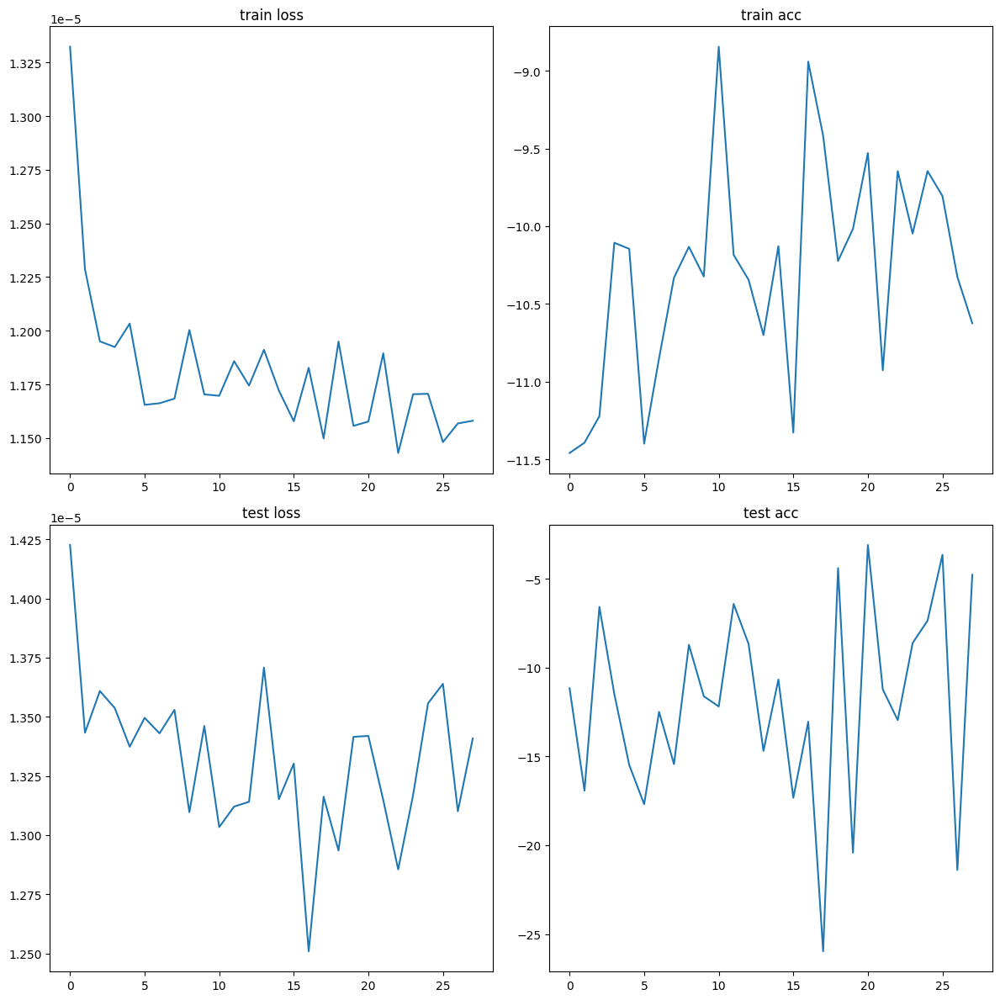

In [ ]:
# plot the loss & accuracy over the course of training
fig, axs = plt.subplots(2, 2, figsize=(12,12))
axs[0,0].plot(train_losses)
axs[0,0].set_title('train loss')
axs[0,1].plot(train_accs)
axs[0,1].set_title('train acc')
axs[1,0].plot(test_losses)
axs[1,0].set_title('test loss')
axs[1,1].plot(test_accs)
axs[1,1].set_title('test acc')
plt.tight_layout()
plt.show()

In [ ]:
now = datetime.now()
date_time = now.strftime("%m-%d-%y_%H:%M:%S")
print(f"done at {date_time}")

done at 08-13-23_06:10:09


# train mask decoder AND vision encoder

In [ ]:
# load saved checkpoint
model = SamWrapper(spec_dim=(256,256),
                   sample_rate=44100,
                   resample_rate=22050,
                   saved_model_state_dict=None).to(device)

# Freeze parameters
for name, param in model.sam_model.named_parameters():
  if name.startswith("vision_encoder"):
    param.requires_grad_(True)
  elif name.startswith("prompt_encoder"):
    param.requires_grad_(False)
  elif name.startswith("mask_decoder"):
    param.requires_grad_(True)




# Initialize stats tracking ONLY if not loading new model!
train_losses = []
test_losses = []
train_accs = []
test_accs = []



learning_rate = 1e-5
best_test_loss = float('inf')
best_train_loss = float('inf')




# Set trainable parameters
trainable_parameters = list(model.sam_model.mask_decoder.parameters()) + list (model.sam_model.vision_encoder.parameters())
#trainable_parameters = list(model.sam_model.vision_encoder.parameters())
#trainable_parameters = list(model.sam_model.mask_decoder.parameters())
optimizer = torch.optim.Adam(trainable_parameters, lr=learning_rate, weight_decay=0)







###. trainin' it

train_audio_metadata_json="dev_audio_metadata.json"
test_audio_metadata_json="eval_audio_metadata.json"
fsd_train_location="/content/FSD50K.dev_audio"
fsd_test_location="/content/FSD50K.eval_audio"

model_name = "SAM_mask_decoder_AND_vision_encoder_finetune_run_8"

centroid_diff_hz = 3000.0

train_dataset = AudioPairDataset(audio_dir=fsd_train_location,
                                json_path=train_audio_metadata_json,
                                centroid_diff_hz=centroid_diff_hz,
                                min_duration_s = model.input_chunk_size/model.resample_rate,
                                dummy_mode=False)

test_dataset = AudioPairDataset(audio_dir=fsd_test_location,
                                json_path=test_audio_metadata_json,
                                centroid_diff_hz=centroid_diff_hz,
                                min_duration_s = model.input_chunk_size/model.resample_rate,
                                dummy_mode=False)

train_dataloader = torch.utils.data.DataLoader(dataset=train_dataset,
                                                batch_size=1,
                                                num_workers=0,
                                                shuffle=True)

test_dataloader = torch.utils.data.DataLoader(dataset=test_dataset,
                                                batch_size=1,
                                                num_workers=0,
                                                shuffle=True)


# tracking best loss for stopping condition

patience = 10 # epochs to tolerate lack of improvement
no_improve_counter = 0 # counter to track lack of improvement

num_epochs = 199
# Training and validation loop
for epoch in range(num_epochs):
  print(f"starting epoch {epoch}")
  # Training

  train_loss, train_acc = _train(model=model,
                                dataloader=train_dataloader,
                                optimizer=optimizer,
                                loss_fn=LOGL2loss_freq,
                                acc_fn=si_snr,
                                device=device,
                                verbose=False)

  mean_train_loss = 0 if len(train_losses) == 0 else mean(train_losses)
  mean_train_acc = 0 if len(train_accs) == 0 else mean(train_accs)

  if train_loss < best_train_loss:
    print(f"~~~Best Train loss! {train_loss} <- {best_train_loss}; delta {best_train_loss-train_loss}")
    best_train_loss = train_loss

  delta_loss = train_loss - mean_train_loss
  delta_acc = train_acc - mean_train_acc
  print(f"epoch {epoch} train done -> avg train_loss: {train_loss:.5e} (delta {delta_loss:.5e}), acc: {train_acc:.5e} (delta {delta_acc:.5e})")
  train_losses.append(train_loss)
  train_accs.append(train_acc)

  print(f"mean train_loss so far: {mean(train_losses):.5e}, acc: {mean(train_accs):.5e}")

  # Validation
  test_loss, test_acc = _validate(model=model,
                                  dataloader=test_dataloader,
                                  loss_fn=LOGL2loss_freq,
                                  acc_fn=si_snr,
                                  device=device,
                                  subset_proportion=0.8,
                                  verbose=False)


  if test_loss < best_test_loss:
    print(f"~~~~~~~~~New Best Test Loss! {test_loss:.5e} <- {best_test_loss:.5e} (delta: {test_loss-best_test_loss:.5e})")
    best_test_loss = test_loss
    no_improve_counter = 0

    # save best model
    now = datetime.now()
    date_time = now.strftime("%m-%d-%y_%H:%M:%S")
    loss_name="LOGL2loss_freq"
    checkpoint_path = f'/content/drive/MyDrive/models/best_{model_name}-{loss_name}-lr_{learning_rate}.pth'
    print(f"SAVING checkpoint: {checkpoint_path}")
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'best_test_loss': best_test_loss,
        'train_loss': train_losses,
        'test_loss': test_losses,
        'train_acc': train_accs,
        'test_acc': test_accs,
        'save_time': date_time
          }, checkpoint_path)

    #hack: save a dummy file with some info in the name so i can see it without being there
    info_path = f'/content/drive/MyDrive/models/new_best_{date_time}-{model_name}-{loss_name}-lr_{learning_rate}.pth'
    torch.save(0, info_path)

  else:
    no_improve_counter += 1
    print(f"no improvement, counter at: {no_improve_counter}")

    #hack: save a dummy file with some info in the name so i can see it without being there
    now = datetime.now()
    date_time = now.strftime("%m-%d-%y_%H:%M:%S")
    info_path = f'/content/drive/MyDrive/models/no_improvement_cnt_{no_improve_counter}_epoch_{epoch}_{date_time}-{model_name}-{loss_name}-lr_{learning_rate}.pth'
    torch.save(0, info_path)

  mean_test_loss = 0 if len(test_losses) == 0 else mean(test_losses)
  mean_test_acc = 0 if len(test_accs) == 0 else mean(test_accs)
  delta_loss = test_loss - mean_test_loss
  delta_acc = test_acc - mean_test_acc
  print(f"epoch {epoch} test done -> avg test_loss: {test_loss:.5e} (delta {delta_loss:.5e}), acc: {test_acc:.5e} (delta {delta_acc:.5e})")
  test_losses.append(test_loss)
  test_accs.append(test_acc)
  print(f"mean test_loss so far: {mean(test_losses):.5e}, acc: {mean(test_accs):.5e}")

  # Print stats
  print(f"Epoch {epoch+1}/{num_epochs}:")
  print(f"Train Loss: {train_loss:.5e}, Train Acc: {train_acc:.5e}")
  print(f"Test Loss: {test_loss:.5e}, Test Acc: {test_acc:.5e}")


  if no_improve_counter > patience:
    print("Early stopping due to no improvement!")

    #hack: save a dummy file with some info in the name so i can see it without being there
    now = datetime.now()
    date_time = now.strftime("%m-%d-%y_%H:%M:%S")
    loss_name="LOGL2loss_freq"
    info_path = f'/content/drive/MyDrive/models/STOPPED_EARLY_{model_name}-{loss_name}-lr_{learning_rate}.pth'
    torch.save({
        'epoch': epoch,
        'train_loss': train_losses,
        'test_loss': test_losses
      }, info_path)
    break

  if (epoch + 1) % 5 == 0:
  # save intermediate checkpoint anyway
    now = datetime.now()
    date_time = now.strftime("%m-%d-%y_%H:%M:%S")
    loss_name="LOGL2loss_freq"
    checkpoint_path = f'/content/drive/MyDrive/models/intermediate_epoch_{epoch}_{model_name}-{loss_name}-lr_{learning_rate}.pth'
    print(f"SAVING checkpoint: {checkpoint_path}")
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'best_test_loss': best_test_loss,
        'train_loss': train_losses,
        'test_loss': test_losses,
        'train_acc': train_accs,
        'test_acc': test_accs,
        'save_time': date_time
          }, checkpoint_path)

SamWrapper model n_fft: 2046, win len: 2046, hop len: 255, sample/resample: 2.0 -> input_chunk_size 521730.0
found 2003 files of length 23.66122448979592s or longer
found 913 files of length 23.66122448979592s or longer
starting epoch 0
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.3452714741174883e-05 <- inf; delta inf
epoch 0 train done -> avg train_loss: 1.34527e-05 (delta 1.34527e-05), acc: -1.11994e+01 (delta -1.11994e+01)
mean train_loss so far: 1.34527e-05, acc: -1.11994e+01


  0%|          | 0/730 [00:00<?, ?it/s]

~~~~~~~~~New Best Test Loss! 1.42227e-05 <- inf (delta: -inf)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM_mask_decoder_AND_vision_encoder_finetune_run_8-LOGL2loss_freq-lr_1e-05.pth
epoch 0 test done -> avg test_loss: 1.42227e-05 (delta 1.42227e-05), acc: -7.98940e+00 (delta -7.98940e+00)
mean test_loss so far: 1.42227e-05, acc: -7.98940e+00
Epoch 1/199:
Train Loss: 1.34527e-05, Train Acc: -1.11994e+01
Test Loss: 1.42227e-05, Test Acc: -7.98940e+00
starting epoch 1
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.2290960067034256e-05 <- 1.3452714741174883e-05; delta 1.161754674140628e-06
epoch 1 train done -> avg train_loss: 1.22910e-05 (delta -1.16175e-06), acc: -1.06334e+01 (delta 5.65947e-01)
mean train_loss so far: 1.28718e-05, acc: -1.09164e+01


  0%|          | 0/730 [00:00<?, ?it/s]

~~~~~~~~~New Best Test Loss! 1.40370e-05 <- 1.42227e-05 (delta: -1.85718e-07)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM_mask_decoder_AND_vision_encoder_finetune_run_8-LOGL2loss_freq-lr_1e-05.pth
epoch 1 test done -> avg test_loss: 1.40370e-05 (delta -1.85718e-07), acc: -1.19914e+01 (delta -4.00201e+00)
mean test_loss so far: 1.41298e-05, acc: -9.99041e+00
Epoch 2/199:
Train Loss: 1.22910e-05, Train Acc: -1.06334e+01
Test Loss: 1.40370e-05, Test Acc: -1.19914e+01
starting epoch 2
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.2281872462040779e-05 <- 1.2290960067034256e-05; delta 9.087604993476448e-09
epoch 2 train done -> avg train_loss: 1.22819e-05 (delta -5.89965e-07), acc: -1.09392e+01 (delta -2.28222e-02)
mean train_loss so far: 1.26752e-05, acc: -1.09240e+01


  0%|          | 0/730 [00:00<?, ?it/s]

~~~~~~~~~New Best Test Loss! 1.34569e-05 <- 1.40370e-05 (delta: -5.80027e-07)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM_mask_decoder_AND_vision_encoder_finetune_run_8-LOGL2loss_freq-lr_1e-05.pth
epoch 2 test done -> avg test_loss: 1.34569e-05 (delta -6.72886e-07), acc: -1.07808e+01 (delta -7.90371e-01)
mean test_loss so far: 1.39055e-05, acc: -1.02539e+01
Epoch 3/199:
Train Loss: 1.22819e-05, Train Acc: -1.09392e+01
Test Loss: 1.34569e-05, Test Acc: -1.07808e+01
starting epoch 3
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.2219125582996967e-05 <- 1.2281872462040779e-05; delta 6.274687904381252e-08
epoch 3 train done -> avg train_loss: 1.22191e-05 (delta -4.56057e-07), acc: -1.07551e+01 (delta 1.68892e-01)
mean train_loss so far: 1.25612e-05, acc: -1.08818e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 1
epoch 3 test done -> avg test_loss: 1.35586e-05 (delta -3.46901e-07), acc: -1.26893e+01 (delta -2.43540e+00)
mean test_loss so far: 1.38188e-05, acc: -1.08627e+01
Epoch 4/199:
Train Loss: 1.22191e-05, Train Acc: -1.07551e+01
Test Loss: 1.35586e-05, Test Acc: -1.26893e+01
starting epoch 4
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.1894051414403972e-05 <- 1.2219125582996967e-05; delta 3.250741685929942e-07
epoch 4 train done -> avg train_loss: 1.18941e-05 (delta -6.67117e-07), acc: -1.00204e+01 (delta 8.61358e-01)
mean train_loss so far: 1.24277e-05, acc: -1.07095e+01


  0%|          | 0/730 [00:00<?, ?it/s]

~~~~~~~~~New Best Test Loss! 1.30485e-05 <- 1.34569e-05 (delta: -4.08407e-07)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM_mask_decoder_AND_vision_encoder_finetune_run_8-LOGL2loss_freq-lr_1e-05.pth
epoch 4 test done -> avg test_loss: 1.30485e-05 (delta -7.70272e-07), acc: -1.09161e+01 (delta -5.34061e-02)
mean test_loss so far: 1.36647e-05, acc: -1.08734e+01
Epoch 5/199:
Train Loss: 1.18941e-05, Train Acc: -1.00204e+01
Test Loss: 1.30485e-05, Test Acc: -1.09161e+01
SAVING checkpoint: /content/drive/MyDrive/models/intermediate_epoch_4_SAM_mask_decoder_AND_vision_encoder_finetune_run_8-LOGL2loss_freq-lr_1e-05.pth
starting epoch 5
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.1867545661587322e-05 <- 1.1894051414403972e-05; delta 2.6505752816650074e-08
epoch 5 train done -> avg train_loss: 1.18675e-05 (delta -5.60199e-07), acc: -9.68052e+00 (delta 1.02900e+00)
mean train_loss so far: 1.23344e-05, acc: -1.05380e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 1
epoch 5 test done -> avg test_loss: 1.33499e-05 (delta -3.14870e-07), acc: -1.51737e+01 (delta -4.30027e+00)
mean test_loss so far: 1.36123e-05, acc: -1.15901e+01
Epoch 6/199:
Train Loss: 1.18675e-05, Train Acc: -9.68052e+00
Test Loss: 1.33499e-05, Test Acc: -1.51737e+01
starting epoch 6
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.1678364119267094e-05 <- 1.1867545661587322e-05; delta 1.8918154232022841e-07
epoch 6 train done -> avg train_loss: 1.16784e-05 (delta -6.56014e-07), acc: -8.76802e+00 (delta 1.77000e+00)
mean train_loss so far: 1.22407e-05, acc: -1.02852e+01


  0%|          | 0/730 [00:00<?, ?it/s]

~~~~~~~~~New Best Test Loss! 1.28971e-05 <- 1.30485e-05 (delta: -1.51436e-07)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM_mask_decoder_AND_vision_encoder_finetune_run_8-LOGL2loss_freq-lr_1e-05.pth
epoch 6 test done -> avg test_loss: 1.28971e-05 (delta -7.15176e-07), acc: -1.79746e+01 (delta -6.38451e+00)
mean test_loss so far: 1.35101e-05, acc: -1.25022e+01
Epoch 7/199:
Train Loss: 1.16784e-05, Train Acc: -8.76802e+00
Test Loss: 1.28971e-05, Test Acc: -1.79746e+01
starting epoch 7
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.147262837666681e-05 <- 1.1678364119267094e-05; delta 2.0573574260028447e-07
epoch 7 train done -> avg train_loss: 1.14726e-05 (delta -7.68034e-07), acc: -9.37504e+00 (delta 9.10127e-01)
mean train_loss so far: 1.21447e-05, acc: -1.01714e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 1
epoch 7 test done -> avg test_loss: 1.33440e-05 (delta -1.66110e-07), acc: -7.52706e+00 (delta 4.97512e+00)
mean test_loss so far: 1.34893e-05, acc: -1.18803e+01
Epoch 8/199:
Train Loss: 1.14726e-05, Train Acc: -9.37504e+00
Test Loss: 1.33440e-05, Test Acc: -7.52706e+00
starting epoch 8
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 8 train done -> avg train_loss: 1.16388e-05 (delta -5.05841e-07), acc: -9.70150e+00 (delta 4.69899e-01)
mean train_loss so far: 1.20885e-05, acc: -1.01192e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 2
epoch 8 test done -> avg test_loss: 1.32780e-05 (delta -2.11341e-07), acc: -5.38535e+00 (delta 6.49494e+00)
mean test_loss so far: 1.34659e-05, acc: -1.11586e+01
Epoch 9/199:
Train Loss: 1.16388e-05, Train Acc: -9.70150e+00
Test Loss: 1.32780e-05, Test Acc: -5.38535e+00
starting epoch 9
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 9 train done -> avg train_loss: 1.15992e-05 (delta -4.89236e-07), acc: -8.90155e+00 (delta 1.21764e+00)
mean train_loss so far: 1.20395e-05, acc: -9.99742e+00


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 3
epoch 9 test done -> avg test_loss: 1.30376e-05 (delta -4.28301e-07), acc: -4.13093e+00 (delta 7.02770e+00)
mean test_loss so far: 1.34230e-05, acc: -1.04559e+01
Epoch 10/199:
Train Loss: 1.15992e-05, Train Acc: -8.90155e+00
Test Loss: 1.30376e-05, Test Acc: -4.13093e+00
SAVING checkpoint: /content/drive/MyDrive/models/intermediate_epoch_9_SAM_mask_decoder_AND_vision_encoder_finetune_run_8-LOGL2loss_freq-lr_1e-05.pth
starting epoch 10
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 10 train done -> avg train_loss: 1.18246e-05 (delta -2.14910e-07), acc: -1.02950e+01 (delta -2.97551e-01)
mean train_loss so far: 1.20200e-05, acc: -1.00245e+01


  0%|          | 0/730 [00:00<?, ?it/s]

~~~~~~~~~New Best Test Loss! 1.26203e-05 <- 1.28971e-05 (delta: -2.76780e-07)
SAVING checkpoint: /content/drive/MyDrive/models/best_SAM_mask_decoder_AND_vision_encoder_finetune_run_8-LOGL2loss_freq-lr_1e-05.pth
epoch 10 test done -> avg test_loss: 1.26203e-05 (delta -8.02712e-07), acc: -9.04377e+00 (delta 1.41209e+00)
mean test_loss so far: 1.33500e-05, acc: -1.03275e+01
Epoch 11/199:
Train Loss: 1.18246e-05, Train Acc: -1.02950e+01
Test Loss: 1.26203e-05, Test Acc: -9.04377e+00
starting epoch 11
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 11 train done -> avg train_loss: 1.17870e-05 (delta -2.33030e-07), acc: -9.95339e+00 (delta 7.10850e-02)
mean train_loss so far: 1.20006e-05, acc: -1.00186e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 1
epoch 11 test done -> avg test_loss: 1.33304e-05 (delta -1.96983e-08), acc: -1.85682e+01 (delta -8.24068e+00)
mean test_loss so far: 1.33484e-05, acc: -1.10142e+01
Epoch 12/199:
Train Loss: 1.17870e-05, Train Acc: -9.95339e+00
Test Loss: 1.33304e-05, Test Acc: -1.85682e+01
starting epoch 12
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 12 train done -> avg train_loss: 1.15951e-05 (delta -4.05443e-07), acc: -1.09383e+01 (delta -9.19737e-01)
mean train_loss so far: 1.19694e-05, acc: -1.00893e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 2
epoch 12 test done -> avg test_loss: 1.35078e-05 (delta 1.59412e-07), acc: -1.44258e+01 (delta -3.41162e+00)
mean test_loss so far: 1.33607e-05, acc: -1.12766e+01
Epoch 13/199:
Train Loss: 1.15951e-05, Train Acc: -1.09383e+01
Test Loss: 1.35078e-05, Test Acc: -1.44258e+01
starting epoch 13
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 13 train done -> avg train_loss: 1.17196e-05 (delta -2.49758e-07), acc: -9.65640e+00 (delta 4.32904e-01)
mean train_loss so far: 1.19515e-05, acc: -1.00584e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 3
epoch 13 test done -> avg test_loss: 1.29440e-05 (delta -4.16694e-07), acc: -9.61078e+00 (delta 1.66586e+00)
mean test_loss so far: 1.33309e-05, acc: -1.11577e+01
Epoch 14/199:
Train Loss: 1.17196e-05, Train Acc: -9.65640e+00
Test Loss: 1.29440e-05, Test Acc: -9.61078e+00
starting epoch 14
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 14 train done -> avg train_loss: 1.18025e-05 (delta -1.49038e-07), acc: -9.65509e+00 (delta 4.03285e-01)
mean train_loss so far: 1.19416e-05, acc: -1.00315e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 4
epoch 14 test done -> avg test_loss: 1.31566e-05 (delta -1.74298e-07), acc: -4.75222e+00 (delta 6.40543e+00)
mean test_loss so far: 1.33193e-05, acc: -1.07306e+01
Epoch 15/199:
Train Loss: 1.18025e-05, Train Acc: -9.65509e+00
Test Loss: 1.31566e-05, Test Acc: -4.75222e+00
SAVING checkpoint: /content/drive/MyDrive/models/intermediate_epoch_14_SAM_mask_decoder_AND_vision_encoder_finetune_run_8-LOGL2loss_freq-lr_1e-05.pth
starting epoch 15
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 15 train done -> avg train_loss: 1.16079e-05 (delta -3.33746e-07), acc: -1.12916e+01 (delta -1.26011e+00)
mean train_loss so far: 1.19208e-05, acc: -1.01102e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 5
epoch 15 test done -> avg test_loss: 1.29567e-05 (delta -3.62540e-07), acc: -1.21948e+01 (delta -1.46415e+00)
mean test_loss so far: 1.32966e-05, acc: -1.08221e+01
Epoch 16/199:
Train Loss: 1.16079e-05, Train Acc: -1.12916e+01
Test Loss: 1.29567e-05, Test Acc: -1.21948e+01
starting epoch 16
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 16 train done -> avg train_loss: 1.18515e-05 (delta -6.92670e-08), acc: -1.01876e+01 (delta -7.73643e-02)
mean train_loss so far: 1.19167e-05, acc: -1.01148e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 6
epoch 16 test done -> avg test_loss: 1.33854e-05 (delta 8.88038e-08), acc: -6.52069e+00 (delta 4.30145e+00)
mean test_loss so far: 1.33019e-05, acc: -1.05691e+01
Epoch 17/199:
Train Loss: 1.18515e-05, Train Acc: -1.01876e+01
Test Loss: 1.33854e-05, Test Acc: -6.52069e+00
starting epoch 17
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 17 train done -> avg train_loss: 1.15913e-05 (delta -3.25398e-07), acc: -9.82654e+00 (delta 2.88264e-01)
mean train_loss so far: 1.18986e-05, acc: -1.00988e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 7
epoch 17 test done -> avg test_loss: 1.35995e-05 (delta 2.97639e-07), acc: -4.95798e+00 (delta 5.61112e+00)
mean test_loss so far: 1.33184e-05, acc: -1.02574e+01
Epoch 18/199:
Train Loss: 1.15913e-05, Train Acc: -9.82654e+00
Test Loss: 1.35995e-05, Test Acc: -4.95798e+00
starting epoch 18
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 18 train done -> avg train_loss: 1.17586e-05 (delta -1.40034e-07), acc: -9.88837e+00 (delta 2.10418e-01)
mean train_loss so far: 1.18912e-05, acc: -1.00877e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 8
epoch 18 test done -> avg test_loss: 1.31239e-05 (delta -1.94519e-07), acc: -1.07138e+01 (delta -4.56397e-01)
mean test_loss so far: 1.33081e-05, acc: -1.02814e+01
Epoch 19/199:
Train Loss: 1.17586e-05, Train Acc: -9.88837e+00
Test Loss: 1.31239e-05, Test Acc: -1.07138e+01
starting epoch 19
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

~~~Best Train loss! 1.1442839362960946e-05 <- 1.147262837666681e-05; delta 2.978901370586302e-08
epoch 19 train done -> avg train_loss: 1.14428e-05 (delta -4.48389e-07), acc: -1.09303e+01 (delta -8.42568e-01)
mean train_loss so far: 1.18688e-05, acc: -1.01298e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 9
epoch 19 test done -> avg test_loss: 1.32028e-05 (delta -1.05316e-07), acc: -1.33239e+01 (delta -3.04254e+00)
mean test_loss so far: 1.33029e-05, acc: -1.04335e+01
Epoch 20/199:
Train Loss: 1.14428e-05, Train Acc: -1.09303e+01
Test Loss: 1.32028e-05, Test Acc: -1.33239e+01
SAVING checkpoint: /content/drive/MyDrive/models/intermediate_epoch_19_SAM_mask_decoder_AND_vision_encoder_finetune_run_8-LOGL2loss_freq-lr_1e-05.pth
starting epoch 20
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 20 train done -> avg train_loss: 1.16398e-05 (delta -2.28976e-07), acc: -9.28597e+00 (delta 8.43867e-01)
mean train_loss so far: 1.18579e-05, acc: -1.00897e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 10
epoch 20 test done -> avg test_loss: 1.27056e-05 (delta -5.97288e-07), acc: -5.67386e+00 (delta 4.75967e+00)
mean test_loss so far: 1.32744e-05, acc: -1.02069e+01
Epoch 21/199:
Train Loss: 1.16398e-05, Train Acc: -9.28597e+00
Test Loss: 1.27056e-05, Test Acc: -5.67386e+00
starting epoch 21
choosing audio of 521730 samples -> 11.83061s


  0%|          | 0/2003 [00:00<?, ?it/s]

epoch 21 train done -> avg train_loss: 1.14695e-05 (delta -3.88357e-07), acc: -1.00484e+01 (delta 4.12912e-02)
mean train_loss so far: 1.18403e-05, acc: -1.00878e+01


  0%|          | 0/730 [00:00<?, ?it/s]

no improvement, counter at: 11
epoch 21 test done -> avg test_loss: 1.33391e-05 (delta 6.46379e-08), acc: -1.21073e+01 (delta -1.90039e+00)
mean test_loss so far: 1.32774e-05, acc: -1.02933e+01
Epoch 22/199:
Train Loss: 1.14695e-05, Train Acc: -1.00484e+01
Test Loss: 1.33391e-05, Test Acc: -1.21073e+01
Early stopping due to no improvement!


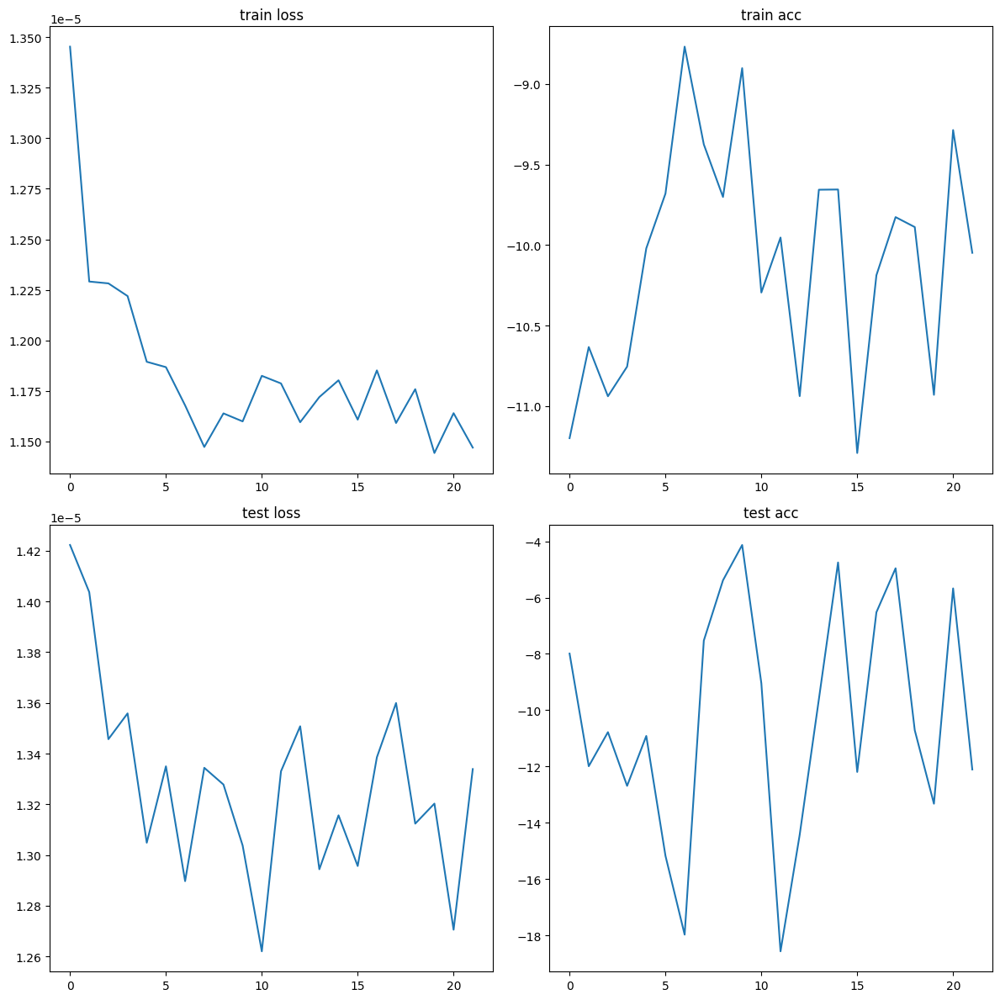

In [ ]:
# plot the loss & accuracy over the course of training
fig, axs = plt.subplots(2, 2, figsize=(12,12))
axs[0,0].plot(train_losses)
axs[0,0].set_title('train loss')
axs[0,1].plot(train_accs)
axs[0,1].set_title('train acc')
axs[1,0].plot(test_losses)
axs[1,0].set_title('test loss')
axs[1,1].plot(test_accs)
axs[1,1].set_title('test acc')
plt.tight_layout()
plt.show()

In [ ]:
del x
del model

NameError: ignored